In [1]:
from comet_ml import Experiment
from jupyterplot import ProgressPlot
from asset.utils import *
%matplotlib inline
dtype = torch.FloatTensor

torch.utils.backcompat.broadcast_warning.enabled = True
torch.manual_seed(1)
if torch.cuda.is_available():
    torch.cuda.manual_seed(1)
torch.cuda.empty_cache()

rand.seed(1)

np.random.seed(1)

cuda_devices = list()

infrencePhase=True
resolution=128
seqLength=20
maxResultSpeed=4
minResultSpeed=2
avDev = torch.device("cpu")
if torch.cuda.is_available(): #Change this block if you want to use GPU
    cuda_devices = [1] #Your GPU Number
    avDev = torch.device("cuda:"+str(cuda_devices[0]))
    if(len(cuda_devices) > 0):
        torch.cuda.set_device(cuda_devices[0])
batch_multiplier = max(len(cuda_devices), 1)


NOTVALID=cv2.resize(cv2.imread('asset/notValid.jpg')[:,:,1], dsize=(resolution-2, resolution-2), 
                                     interpolation=cv2.INTER_CUBIC)
NOTVALID=cv2.copyMakeBorder(NOTVALID, 1, 1, 1, 1, cv2.BORDER_CONSTANT, None, 0)
NOTVALID=torch.from_numpy(NOTVALID).unsqueeze(0).to(avDev).float()/255.

Files already downloaded and verified
Init worker seed: 1
torch.Size([100, 1, 20, 128, 128]) torch.FloatTensor tensor([9]) tensor([[[2.5000, 2.5000]]], dtype=torch.float64)
Data: min and max 0.0 1.0


<b><span style="color: #ff0000">initailSeq (r)</span></b>  (1, 20, 128, 128, 1)

Image: min and max 0.0 1.0


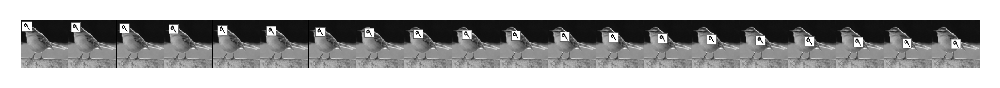

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.052941177 0.9490196
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">initailSeq (r)</span></b>  (1, 20, 530, 128, 1)

Image: min and max 0.0 1.0


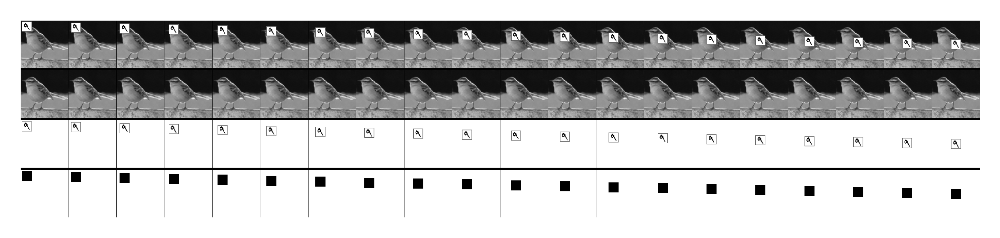

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">rotA R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


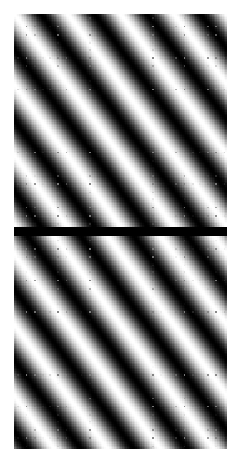

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">rotFG R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


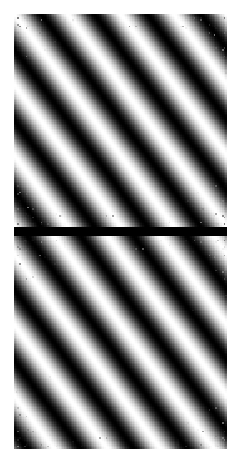

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">rotTFG R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


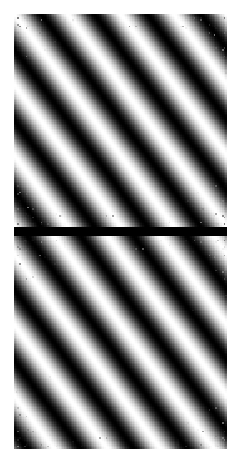

In [2]:
bs=100
def worker_init_fn(worker_id):  
    worker_id=worker_id+1
    print("Init worker seed:",worker_id)
    torch.manual_seed(worker_id)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(worker_id)
    rand.seed(worker_id)
    np.random.seed(worker_id)
    
ds = MovingFGOnBGDataset(infrencePhase=infrencePhase,seqLength=seqLength,shape=resolution,minResultSpeed=minResultSpeed,maxResultSpeed=maxResultSpeed,foregroundScale=1,background="STL10",foreground="MNIST")
ds_loader = DataLoader(ds,batch_size=bs, shuffle=not infrencePhase,num_workers=1,worker_init_fn=worker_init_fn)
for s in ds_loader:
    li=7;ui=li+1
    print(s['GT'].shape,s['GT'].type(),s['foreground'][li:ui],s["velocity"][li:ui])
    showSeq(False,-1,"initailSeq",s['GT'][li:ui].cpu(),oneD=False,dpi=3,revert=True)
    dataSet=s['GT'].to(avDev)
    dsBG=s['BG'].to(avDev)
    dsFG=s['FG'].to(avDev)
    dsAlpha=s['A'].to(avDev)
    showSeq(False,-1,"initailSeq",dataSet[li:ui].cpu(),[dsBG[li:ui].cpu(),dsFG[li:ui].cpu(),dsAlpha[li:ui].cpu()],oneD=dimention==1,dpi=3,revert=True)
    rotA,rotFG,rotTFG=generateAllRot(dsAlpha,dsFG)
    showComplex(True,1,"rotA",rotA,True)
    showComplex(True,1,"rotFG",rotFG,True)
    showComplex(True,1,"rotTFG",rotTFG,True)
    break

In [3]:
def showComplex(norm,step,name,a,justRI=False):
    tmp=visshift(a)[li:ui].permute(0,3,1,2).unsqueeze(1).cpu().detach()
    showSeq(norm,step,name+" R&I "+str(step),tmp[:,:,0:1,:,:],[tmp[:,:,1:2,:,:]],oneD=dimention==1,revert=True,dpi=1)
    if justRI:
        return
    angle=torch.atan2(tmp[:,:,1:2,:,:],tmp[:,:,0:1,:,:])
    absol=torch.sqrt(tmp[:,:,1:2,:,:]*tmp[:,:,1:2,:,:]+tmp[:,:,0:1,:,:]*tmp[:,:,0:1,:,:]+ 1e-8)
    showSeq(norm,step,name+" Abs "+str(step),absol,oneD=dimention==1,revert=True,dpi=2)
    showSeq(norm,step,name+" Angl "+str(step),angle,oneD=dimention==1,revert=True,dpi=2)
    

In [4]:
def getPhaseDiff(hf0,hf1):
    R = complex_mul(hf0,complex_conj(hf1))
    R = complex_div(R,complex_abs(R))
    return R

torch.Size([100, 1, 20, 128, 128]) torch.FloatTensor tensor([9]) tensor([[[2.5000, 2.5000]]], dtype=torch.float64)
Data: min and max -0.99969894 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">rotA R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


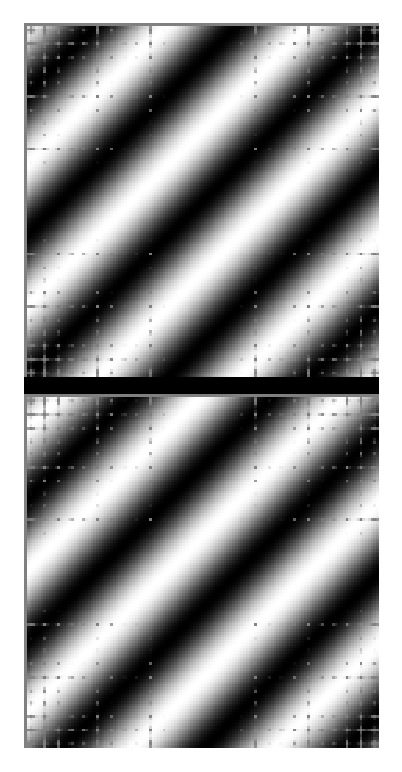

In [5]:
li=9;ui=li+1
print(s['GT'].shape,s['GT'].type(),s['foreground'][li:ui],s["velocity"][li:ui])
showComplex(True,1,"rotA",rotA,True)

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">rotFGtt R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


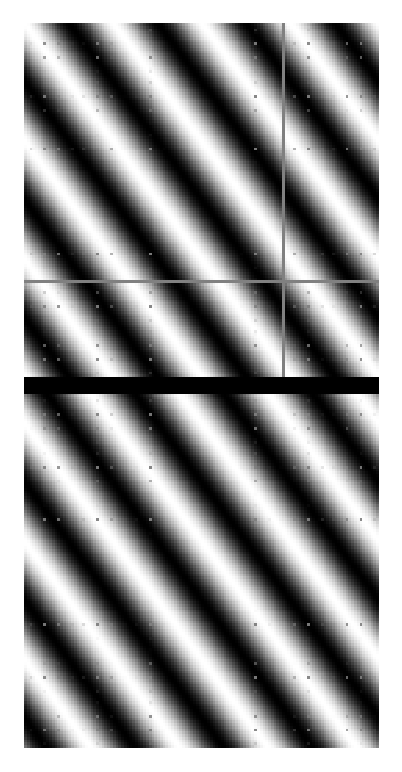

torch.Size([100, 1, 20, 128, 128]) torch.FloatTensor tensor([1]) tensor([[[ 3., -4.]]], dtype=torch.float64)
Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">rotFGtt R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


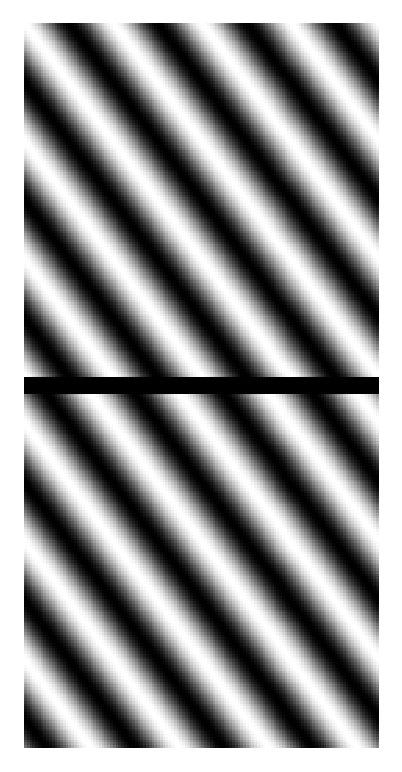

Data: min and max -0.9999998 0.9999998
Data[ 0 ]: min and max -0.94330233 0.94315475


<b><span style="color: #ff0000">diff R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


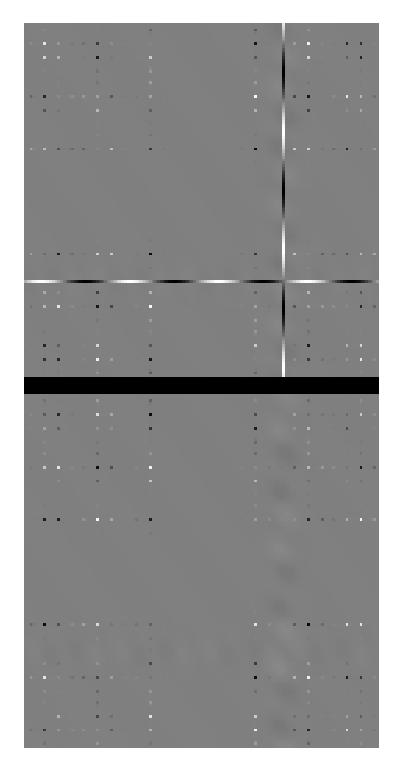

In [6]:
import kornia
rotFGtt=rotA.clone()
rotFGtt[:,29:30,:,0]=torch.zeros_like(rotFGtt[:,29:30,:,0])
rotFGtt[:,:,29:30,0]=torch.zeros_like(rotFGtt[:,:,29:30,0])
# rotFGtt+=torch.randn_like(rotFGtt)*0.05
rotFGtt=torch.clamp(rotFGtt,-1,1)
rotFGttc=rotFGtt.clone()
li=5;ui=li+1
showComplex(True,1,"rotFGtt",rotFGtt,True)
EFG=(getEnergy(dsFG[:,0,0,:,:],dsFG[:,0,1,:,:]))
# showComplex(True,1,"EFG",EFG,True)
print(s['GT'].shape,s['GT'].type(),s['foreground'][li:ui],s["velocity"][li:ui])
# def smoothIt(rot,energy=None,gainEst=0.2,step=1,axis=0,show=False,dims=(1,2)):
#     oAxis=1 if axis==0 else 0
#     a=getPhaseDiff(rot,rot.roll(-step,dims=dims[axis]))
#     if(show):
#         showComplex(True,1,"a",a,True)
#     if energy is not None:
#         am=(a*energy).sum(dim=dims[oAxis])/energy.sum(dim=dims[oAxis])
#     else:
#         am=a.mean(dim=dims[oAxis])
#     if(show):
#         amshow=am.unsqueeze(2).repeat(1,1,resolution,1) if axis==0 else am.unsqueeze(1).repeat(1,resolution,1,1)
#         showComplex(True,1,"am",amshow,True)
#     amm=am.mean(dim=1).unsqueeze(1).unsqueeze(2).repeat(1,resolution,resolution,1)
#     if(show):
#         showComplex(True,1,"amm",amm,True)
#     newEs=complex_mul(rot.roll(-step,dims=dims[axis]),amm)
#     newEs2=complex_mul(rot,amm)
#     rot=(1-gainEst)*rot+(gainEst)*newEs
#     rot = complex_div(rot,complex_abs(rot))
#     if(show):
#         showComplex(True,1,"newEs",newEs,True)
# #     rot=torch.clamp(rot,-1,1)
#     return rot
for j in range(10):
    for i in range(1,3):
        rotFGtt=smoothIt(rot=rotFGtt,energy=EFG,gainEst=0.5,step=-i if j%2==0 else i,axis=0,show=False)
        rotFGtt=smoothIt(rot=rotFGtt,energy=EFG,gainEst=0.5,step=-i if j%2==0 else i,axis=1,show=False)

    
showComplex(True,1,"rotFGtt",rotFGtt,True)
showComplex(True,1,"diff",(rotFGtt-rotFGttc),True)

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">rotFGtt R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


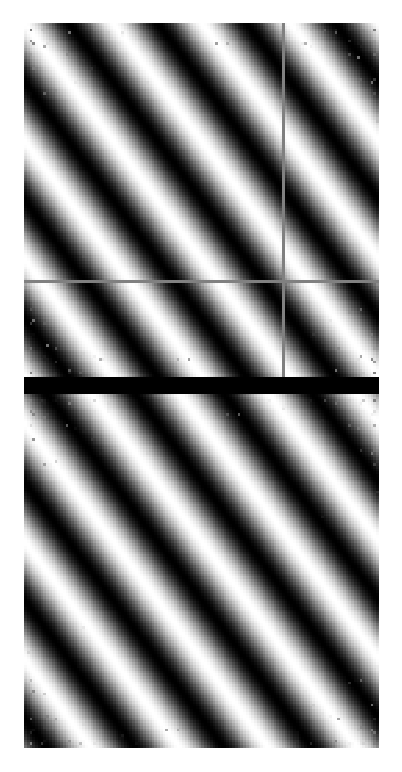

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">rotFG2 R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


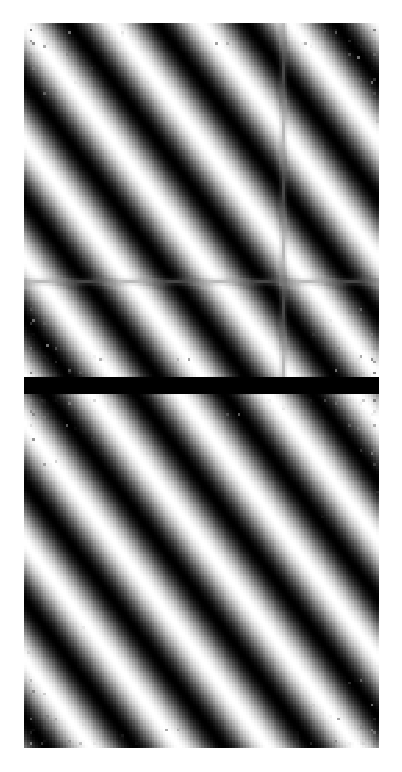

Data: min and max -0.47133565 0.47154656
Data[ 0 ]: min and max 0.0 0.0


<b><span style="color: #ff0000">diff R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 0.9997763633728027


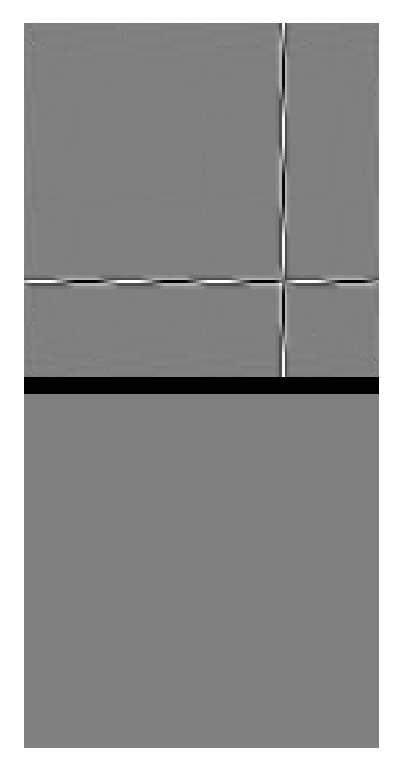

In [7]:
import kornia
rotFGtt=rotFG.clone()
# rotFGtt[:,110:120,110:120,0]-=torch.ones_like(rotFGtt[:,110:120,110:120,0])*6
# rotFGtt[:,110:120,110:120,0]+=torch.ones_like(rotFGtt[:,110:120,110:120,0])*3
# rotFGtt[:,110:120,110:120,0]+=torch.randn_like(rotFGtt[:,110:120,110:120,0])*0.1
# rotFGtt[:-2,29:30,:,0]=(rotFGtt[2:,29:30,:,0])
rotFGtt[:,29:30,:,0]=torch.zeros_like(rotFGtt[:,29:30,:,0])
rotFGtt[:,:,29:30,0]=torch.zeros_like(rotFGtt[:,:,29:30,0])
rotFGtt=torch.clamp(rotFGtt,-1,1)
rotFGttc=rotFGtt.clone()
li=5;ui=li+1
EFG=(getEnergy(dsFG[:,0,0,:,:],dsFG[:,0,1,:,:]))/16384
EFG.fill_(1)
showComplex(True,1,"rotFGtt",rotFGtt,True)
# showComplex(True,1,"EFG",EFG,True)
for i in range(10):
    rotFGtt.detach_()
    rotFGtt.requires_grad_()
    
    a=(rotFGtt[:,:,1:,0]-rotFGtt[:,:,:-1,0]).abs()
    a2=(rotFGtt[:,1:,:,0]-rotFGtt[:,:-1,:,0]).abs()
#     a2=(rotFGtt[:,1:,:,:]*EFG[:,1:,:,:]-rotFGtt[:,:-1,:,:]*EFG[:,:-1,:,:]).abs()
#     showComplex(True,1,"a",a,True)
#     showComplex(True,1,"a2",a2.unsqueeze(-1).repeat(1,1,1,2),True)
    
    a=a.mean(dim=1)
    a2=a2.mean(dim=2)
#     showComplex(True,1,"a2",a2.unsqueeze(-1).unsqueeze(-1).repeat(1,1,128,2),True)
#     showComplex(True,1,"a2",a2.mean(dim=1).unsqueeze(-1).unsqueeze(-1).unsqueeze(-1).repeat(1,128,128,2),True)


    l=torch.pow(a-a.mean(dim=1).unsqueeze(1).repeat(1, 127).detach(),2).mean()
    l=l+torch.pow(a2-a2.mean(dim=1).unsqueeze(1).repeat(1, 127).detach(),2).mean()
    
    
    
#     l=torch.pow(a2-a2.mean(dim=1).unsqueeze(1).repeat(1, 127),2).mean()
    
    l.backward()
#     showComplex(True,1,"grad",rotFGtt.grad,True)
#     print(l.item())
    rotFGtt=(rotFGtt-(100000*rotFGtt.grad))
    
#     if i%5==0:
#         gauss = kornia.filters.GaussianBlur2d((3, 3), (3, 3))

#         # blur the image
#         rotFGtt[:,:,:,0] = gauss(rotFGtt[:,:,:,0].unsqueeze(1)).squeeze(1)
#         rotFGtt[:,:,:,1] = gauss(rotFGtt[:,:,:,1].unsqueeze(1)).squeeze(1)

rotFGtt=torch.clamp(rotFGtt,-1,1)
showComplex(True,1,"rotFG2",rotFGtt,True)
showComplex(True,1,"diff",(rotFGtt-rotFGttc),True)

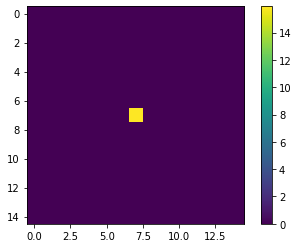

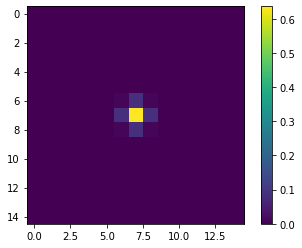

torch.Size([100, 1, 20, 128, 128])
torch.Size([1, 1, 128, 128])


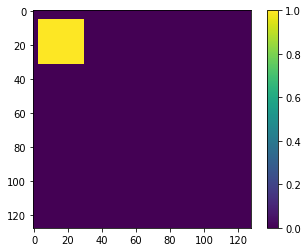

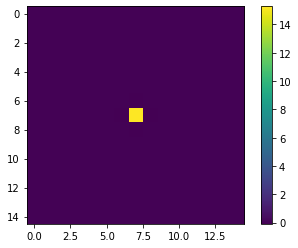

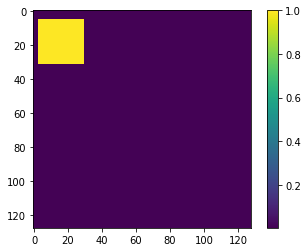

In [8]:
filters = torch.zeros(1,1,15,15).to(avDev)
g1=return2DGaussian(15,torch.tensor([0.1]).float().to(avDev))
g2=return2DGaussian(15,torch.tensor([0.5]).float().to(avDev))
showSingleImg(img=g1[0,:,:,:])
showSingleImg(img=g2[0,:,:,:])
filters=(g1-g2)#https://en.wikipedia.org/wiki/Difference_of_Gaussians
print(dsAlpha.shape)
inputs = dsAlpha[0:1,:,0,:,:]#torch.randn(1,1,64,64).to(avDev)
rangeFilters=(filters.max(),filters.min())
res=((F.conv2d(inputs, filters, padding=filters.shape[2]//2,stride=1)))
print(res.shape)
showSingleImg(img=inputs[0,:,:,:])
showSingleImg(img=filters[0,:,:,:])
showSingleImg(img=clmp(res[0,:,:,:],True))

In [9]:
import torch.nn as nn
class CNNModelA(nn.Module):
    def __init__(self):
        super(CNNModelA, self).__init__()
        
        hu=4
        self.c1=nn.Conv2d(in_channels=1, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c2=nn.Conv2d(in_channels=1+hu, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c3=nn.Conv2d(in_channels=1+hu*2, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c4=nn.Conv2d(in_channels=1+hu*3, out_channels=1, kernel_size=3, stride=1, padding=1)
        self.r=nn.ReLU()

    
    def forward(self, inp):
        inp=inp.unsqueeze(1)
        out1 = self.r(self.c1(inp))
        out2 = self.r(self.c2(torch.cat([out1, inp], 1)))
        out3 = self.r(self.c3(torch.cat([out2 ,out1, inp], 1)))
        out = self.r(self.c4(torch.cat([out3 ,out2 ,out1, inp], 1)))
        return (out).squeeze(1)
    
class CNNModelBG(nn.Module):
    def __init__(self):
        super(CNNModelBG, self).__init__()
        
        hu=4
        self.c1=nn.Conv2d(in_channels=2, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c2=nn.Conv2d(in_channels=2+hu, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c3=nn.Conv2d(in_channels=2+hu*2, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c4=nn.Conv2d(in_channels=2+hu*3, out_channels=1, kernel_size=3, stride=1, padding=1)
        self.r=nn.ReLU()

    
    def forward(self, inp,A):
        inp=inp.unsqueeze(1)
        A=A.unsqueeze(1)
        inp=torch.cat([inp, A], 1)
        out1 = self.r(self.c1(inp))
        out2 = self.r(self.c2(torch.cat([out1, inp], 1)))
        out3 = self.r(self.c3(torch.cat([out2 ,out1, inp], 1)))
        out = self.r(self.c4(torch.cat([out3 ,out2 ,out1, inp], 1)))
        return (out).squeeze(1)
    
class CNNModelFG(nn.Module):
    def __init__(self):
        super(CNNModelFG, self).__init__()
        
        hu=4
        self.c1=nn.Conv2d(in_channels=1, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c2=nn.Conv2d(in_channels=1+hu, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c3=nn.Conv2d(in_channels=1+hu*2, out_channels=hu, kernel_size=3, stride=1, padding=1)
        self.c4=nn.Conv2d(in_channels=1+hu*3, out_channels=1, kernel_size=3, stride=1, padding=1)
        self.r=nn.ReLU()

    
    def forward(self, inp):
        inp=inp.unsqueeze(1)
        out1 = self.r(self.c1(inp))
        out2 = self.r(self.c2(torch.cat([out1, inp], 1)))
        out3 = self.r(self.c3(torch.cat([out2 ,out1, inp], 1)))
        out = self.r(self.c4(torch.cat([out3 ,out2 ,out1, inp], 1)))
        return (out).squeeze(1) 

In [10]:
modelA = CNNModelA().to(avDev)
modelBG = CNNModelBG().to(avDev)
modelFG = CNNModelFG().to(avDev)
sum(p.numel() for p in modelA.parameters() if p.requires_grad)+sum(p.numel() for p in modelBG.parameters() if p.requires_grad)+sum(p.numel() for p in modelFG.parameters() if p.requires_grad)

2127

In [11]:
from torch.autograd import grad
def optimizeIt(inp):
    global bestLoss,bestParams,step,experiment,SHOWBEST,filters,g1,g2
    torch.set_grad_enabled(True)
    DS=dataSet[:,0,:,:,:].clone()

#     A=dsAlpha[:,0,0,:,:]
#     BG=dsBG[:,0,0,:,:]
#     FG=dsFG[:,0,0,:,:]
#     A=clmp(dataSet[:,0,0,:,:]*learnableGainsInit[0,0]+learnableGainsInit[0,1],True)
    AEstmiate=[clmp(modelA(dataSet[:,0,i,:,:]),True) for i in range(seqLength)]
    A=AEstmiate[0]
#     BG=clmp(dataSet[:,0,0,:,:]*learnableGainsInit[1,0]+learnableGainsInit[1,1],True)
    FG=clmp(modelFG(AEstmiate[0]*dataSet[:,0,0,:,:]),False)
    BG=clmp(modelBG((1-AEstmiate[0])*dataSet[:,0,0,:,:],AEstmiate[0]),False)
#     FG=clmp(dataSet[:,0,0,:,:]*learnableGainsInit[2,0]+learnableGainsInit[2,1],True)


    rotA,rotFG,rotTFG=generateAllRot(dsAlpha,dsFG)
    T=complex_conj(rotTFG.clone())
    if SHOWINTER:
        print(inp)
        dsNCC=visshift(ifft(complex_conj(rotA.view(bs,resolution,resolution,2)),2,normalized=normalizeFFT))[:,:,:,0]
        showReal(True,-1,"Actual Normilized Cross-Correlation",dsNCC)
        showComplex(True,1,"Actual Normalized Cross-Power Spectrum ",complex_conj(rotA.view(bs,resolution,resolution,2)))
        showComplex(True,1,"TInit",T)
        showComplex(True,1,"TInitFFT",(ifft(T,2,normalized=normalizeFFT)))

    
    
    
#     T.fill_(0)
#     T[:,:,:,0]=return2DGaussian(resolution,sigma=torch.abs(learnableGainsInit[3,0])+0.01,offset=1).view(1,resolution,resolution).repeat(bs,1,1)
#     T=visshift(T*torch.abs(learnableGainsF[0,0])).clamp(-1,1)
    PDA=complex_conj(getRot(AEstmiate[0],AEstmiate[1]))
    PDFG=complex_conj(getRot(AEstmiate[0]*dataSet[:,0,0,:,:],AEstmiate[1]*dataSet[:,0,1,:,:]))
    T=(PDFG*torch.sigmoid(learnableGainsTeS[0,0])+PDA*(1-torch.sigmoid(learnableGainsTeS[0,0])))
    
    
    EA=(getEnergy(AEstmiate[0],AEstmiate[1]))
    EFG=(getEnergy(AEstmiate[0]*dataSet[:,0,0,:,:],AEstmiate[1]*dataSet[:,0,1,:,:]))
    ET=(EFG*torch.sigmoid(learnableGainsTeS[0,0])+EA*(1-torch.sigmoid(learnableGainsTeS[0,0])))
    for j in range(10):
        for st in range(1,3):
            T=smoothIt(rot=T,energy=ET,gainEst=0.5,step=-st if j%2==0 else st,axis=0,show=False)
            T=smoothIt(rot=T,energy=ET,gainEst=0.5,step=-st if j%2==0 else st,axis=1,show=False)
        
        

    CNT=0
    ARes=[]
    ANRes=[]
    BGRes=[]
    Ttmp=T.clone()
    Ttmp[:,:,:,0].fill_(1)
    Ttmp[:,:,:,1].fill_(0)
    TRes=[visshift(Ttmp)[:,:,:,:].detach().clone()]
    
    if SHOWBEST or SHOWINTER:
        showReal(False,-1,"AInit",A,vmin=0,vmax=1)
        showReal(False,-1,"BGInit",BG,vmin=0,vmax=1)
        showReal(False,-1,"FGInit",FG,vmin=0,vmax=1)
        showComplex(True,1,"TInit",T.detach().clone(),True)
        
    PRes=[]
    if SHOWBEST or SHOWINTER:
        FGRes=[]
        FGNRes=[]
        CRes=[]
        TEstRes=[torch.zeros_like(T)[:,:,:,:]]
    
    for i in range(seqLength):
        NBG=BG
        A_fft = torch.stack((A,torch.zeros((bs,resolution,resolution),dtype=torch.float).to(avDev)),dim=3)
        A_fft = fft(A_fft,2,normalized=normalizeFFT)
        FG_fft = torch.stack((FG,torch.zeros((bs,resolution,resolution),dtype=torch.float).to(avDev)),dim=3)
        FG_fft = fft(FG_fft,2,normalized=normalizeFFT)

        
        Trans =T
        NA_fft=complex_mul(A_fft,Trans)
        NFG_fft=complex_mul(FG_fft,Trans)
            

        gtmp=min(i/5,1)
        NA=AEstmiate[i]*(1-gtmp)+gtmp*clmp(ifft(NA_fft,2,normalized=normalizeFFT)[:,:,:,0],True)
        NFG=FG if i==0 else clmp(ifft(NFG_fft,2,normalized=normalizeFFT)[:,:,:,0],False)
        
        
        if SHOWINTER:
            showReal(False,i,"A",A,vmin=0,vmax=1)
            showComplex(True,i,"A_fft",A_fft)
            showReal(False,i,"FG",FG,vmin=0,vmax=1)
            showComplex(True,i,"FG_fft",FG_fft)
            showReal(False,i,"BG",BG,vmin=0,vmax=1)
            showComplex(True,i,"Trans",Trans)            
            showComplex(True,i,"NA_fft",NA_fft)
            showReal(False,i,"NA",NA,vmin=0,vmax=1)
            showComplex(True,i,"NFG_fft",NFG_fft)
            showReal(False,i,"NFG",NFG,vmin=0,vmax=1)
            
        Res=(NA*NFG)+((1-NA)*NBG)
        ANRes.append(NA.detach().clone())
        if SHOWBEST or SHOWINTER:
            FGNRes.append(NFG.detach().clone())
        
        if i<seedNumber:
            inter=Res-DS[:,i,:,:]
            Err=0.5*torch.pow(inter,2)
            Agrad=NFG*inter-(NBG*inter)
            BGgrad=(1-NA)*inter
            FGgrad=NA*inter
            NA=(NA-Agrad*torch.sigmoid(learnableGains[0,i]))
            idx2up=i
            g1=return2DGaussian(15,learnableGainsDOG[1,idx2up].abs()+0.01)
            g2=return2DGaussian(15,learnableGainsDOG[0,idx2up].abs()+0.02)
            filters=(g1-g2)
            NA=(((F.conv2d(NA.unsqueeze(1), filters, padding=filters.shape[2]//2,stride=1)).squeeze(1)*learnableGainsDOG[2,idx2up])+learnableGainsDOG[3,idx2up])


            NA=clmp(NA,True)
            NBG=clmp(NBG-BGgrad*torch.sigmoid(learnableGains[1,i]),False)
            NFG=clmp(NFG-FGgrad*torch.sigmoid(learnableGains[2,i]),False)
            correction=clmp((NA*NFG)+((1-NA)*NBG))
        else:
            inter=torch.zeros_like(Res)
            Err=torch.zeros_like(Res)
            Agrad=torch.zeros_like(Res)
            BGgrad=torch.zeros_like(Res)
            FGgrad=torch.zeros_like(Res)
            correction=torch.zeros_like(Res)
            
        ARes.append(NA.detach().clone())
        BGRes.append(NBG.detach().clone())
        PRes.append(clmp(Res).clone())
        
        
        if SHOWBEST or SHOWINTER:
            FGRes.append(NFG.detach().clone())
            CRes.append(correction.detach().clone())
            
        if SHOWINTER:
            showReal(False,i,"GT",DS[:,i,:,:],vmin=0,vmax=1)
            showReal(False,i,"PredFrame",Res,vmin=0,vmax=1)
            showReal(True,i,"Error",inter)
            showReal(True,i,"Loss",Err)
            showReal(True,i,"Agrad",Agrad)
            showReal(True,i,"BGgrad",BGgrad)
            showReal(True,i,"FGgrad",FGgrad)
            showReal(True,i,"UpdatedNA",NA,vmin=0,vmax=1)
            showReal(True,i,"UpdatedNBG",NBG,vmin=0,vmax=1)
            showReal(True,i,"UpdatedNFG",NFG,vmin=0,vmax=1)
            showReal(True,i,"Correction",correction,vmin=0,vmax=1)
        
        if i>0:
            if i<seedNumber:
                Agrad_ifft = torch.stack((Agrad,torch.zeros((bs,resolution,resolution),dtype=torch.float).to(avDev)),dim=3)
                Agrad_ifft = complex_conj(fft(complex_conj(Agrad_ifft),2,normalized=normalizeFFT))/float(resolution*resolution)
                FGgrad_ifft = torch.stack((FGgrad,torch.zeros((bs,resolution,resolution),dtype=torch.float).to(avDev)),dim=3)
                FGgrad_ifft = complex_conj(fft(complex_conj(FGgrad_ifft),2,normalized=normalizeFFT))/float(resolution*resolution)
                PDA=getRotComplete(NA,A)
                PDFG=getRotComplete(NFG,FG)
                TEstimate=(PDFG*torch.sigmoid(learnableGainsTeS[0,i])+PDA*(1-torch.sigmoid(learnableGainsTeS[0,i])))
                
                EA=getEnergy(NA,A)
                EFG=getEnergy(NFG,FG)
                ET=(EFG*torch.sigmoid(learnableGainsTeS[0,i])+EA*(1-torch.sigmoid(learnableGainsTeS[0,i])))        
                
                NT=T.clone().requires_grad_()
                NT=((1-torch.sigmoid(learnableGainsF[0,i]))*T)+(torch.sigmoid(learnableGainsF[0,i])*TEstimate)
                
                for st in range(1,5):
                    NT=smoothIt(rot=NT,energy=ET,gainEst=0.5,step=-st if st%2==0 else st,axis=0,show=False)
                    NT=smoothIt(rot=NT,energy=ET,gainEst=0.5,step=-st if st%2==0 else st,axis=1,show=False)              
                
                
                
                

            else:
                TEstimate=torch.zeros_like(TEstimate)

            if SHOWINTER:
                showComplex(True,i,"TEstimate",TEstimate)
                showComplex(True,i,"UpdatedNT",NT)
            if SHOWBEST or SHOWINTER:
                TEstRes.append(visshift(-TEstimate)[:,:,:,:].detach().clone())
            T=NT
            TRes.append(visshift(NT)[:,:,:,:].clone())

        A=NA
        FG=NFG
        BG=NBG
        

        
    ARes,ANRes,BGRes,PRes,TRes=manyListToTensor([ARes,ANRes,BGRes,PRes,TRes])
    L2loss=torch.pow((dataSet-PRes),2)
    loss=L2loss[:,:,seedNumber:,:,:].mean().item()
    if(math.isnan(loss)):
        print(torch.pow((ARes-dsAlpha).cpu(),2).mean().item())
        print(torch.pow((BGRes-dsBG).cpu(),2).mean().item())
        print(torch.pow((dataSet-PRes).cpu(),2).mean().item())
        print(torch.isnan(dataSet-PRes).any())
        raise "NAN Exception"
        
    if SHOWBEST or SHOWINTER:
        FGRes,CRes,TEstRes,FGNRes=manyListToTensor([FGRes,CRes,TEstRes,FGNRes])
        print("Velocity:",dsVel[li:ui])
        experiment.log_image(**showSeq(False,-1,"NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2",ANRes[li:ui].cpu(),[ARes[li:ui].cpu(),BGRes[li:ui].cpu(),FGNRes[li:ui].cpu(),FGRes[li:ui].cpu(),PRes[li:ui].detach().cpu(),CRes[li:ui].cpu(),dataSet[li:ui].cpu(),L2loss[li:ui].detach().cpu()],oneD=dimention==1,revert=True,dpi=2.4))
        experiment.log_image(**showSeq(True,-1,"TRes",TRes[li:ui].cpu()[:,:,:,:,:,0],[TRes[li:ui].cpu()[:,:,:,:,:,1]],oneD=dimention==1,revert=True,dpi=2.4))
        experiment.log_image(**showSeq(False,-1,"NFGU,NAU,BG,Pred,Cor,GT,L2",FGRes[li:ui].cpu(),[ARes[li:ui].cpu(),BGRes[li:ui].cpu(),PRes[li:ui].detach().cpu(),CRes[li:ui].cpu(),dataSet[li:ui].cpu(),L2loss[li:ui].detach().cpu()],oneD=dimention==1,revert=True,dpi=2.4))
        experiment.log_image(**showSeq(False,-1,"Pred,Cor",PRes[li:ui].detach().cpu(),[dataSet[li:ui].cpu()],oneD=dimention==1,revert=True,dpi=2.4))
        experiment.log_image(**showSeq(True,-1,"TEstRes",TEstRes[li:ui].cpu()[:,:,:,:,:,0],[TEstRes[li:ui].cpu()[:,:,:,:,:,1]],oneD=dimention==1,revert=True,dpi=2.4))
   
    if loss<bestLoss:
        bestLoss=loss
        bestParams=inp
        experiment.log_parameters(inp)
        experiment.log_metric("bestLoss", bestLoss, step=step)

    step+=1
    return PRes,loss,L2loss,TRes.mean()

In [12]:
criterion = torch.nn.MSELoss().to(avDev)
critBCE = torch.nn.BCELoss()
critL1 = torch.nn.L1Loss()
critL2 = torch.nn.MSELoss()

learnableGains=torch.ones(3,seqLength).to(avDev)
learnableGainsInit=torch.ones(7,2).to(avDev)
learnableGainsF=torch.ones(1,seqLength).to(avDev)
learnableGainsTeS=torch.zeros(1,seqLength).to(avDev)
learnableGainsDOG=torch.ones(4,seqLength).to(avDev)

if os.path.exists("savedModels/"+theNotebook+".th"):
    loadedModel=torch.load("savedModels/"+theNotebook+".th",map_location=avDev)
    learnableGains=loadedModel["learnableGains"].to(avDev)
    learnableGainsInit=loadedModel["learnableGainsInit"].to(avDev)
    learnableGainsF=loadedModel["learnableGainsF"].to(avDev)
    learnableGainsTeS=loadedModel["learnableGainsTeS"].to(avDev)
    learnableGainsDOG=loadedModel["learnableGainsDOG"].to(avDev)
    modelA.load_state_dict(loadedModel["modelA"])
    modelBG.load_state_dict(loadedModel["modelBG"])
    modelFG.load_state_dict(loadedModel["modelFG"])
#     pprint.pprint(loadedModel)
    print("Loaded!")
else:
    print("Default!")


learnableGains=learnableGains.detach().requires_grad_()
learnableGainsInit=learnableGainsInit.detach().requires_grad_()
learnableGainsF=learnableGainsF.detach().requires_grad_()
learnableGainsTeS=learnableGainsTeS.detach().requires_grad_()
learnableGainsDOG=learnableGainsDOG.detach().requires_grad_()

Loaded!


In [13]:
pp = ProgressPlot(plot_names=["currentLoss", "L2Loss","LR"],line_names=["Line"])

lblLoss = HTML(value='')
lblTotalLoss = HTML(value='')
lblLR = HTML(value='')
oGains = Box(children=[])
box = VBox(children=[lblLoss,lblTotalLoss,lblLR,oGains])
display(box)

<IPython.core.display.Javascript object>

[1e-05, 1e-05, 1e-05, 1e-05, 1e-05, 1e-05, 1e-05, 1e-05]
Number of params= 2321


COMET INFO: old comet version (3.0.2) detected. current: 3.1.0 please update your comet lib with command: `pip install --no-cache-dir --upgrade comet_ml`
COMET INFO: Experiment is live on comet.ml https://www.comet.ml/hfarazi/esann2020/4618ab3bcc2f4f0e9dba7a628b789a75



Init worker seed: 1
Init worker seed: 2
Init worker seed: 3
Init worker seed: 4
Init worker seed: 5
Init worker seed: 6
Init worker seed: 7
Init worker seed: 8
Data: min and max 0.006692851 0.9999453


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 5.4717064e-05 0.9933071


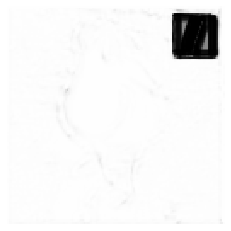

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


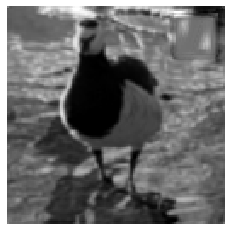

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


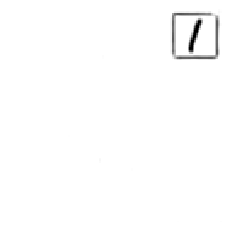

Data: min and max -0.9999997 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


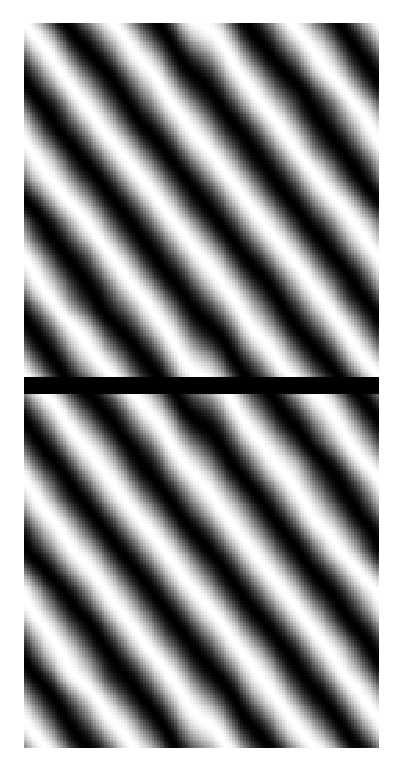

Velocity: tensor([[[ 3., -4.]]], dtype=torch.float64)
Data: min and max 0.0056065475 0.9999453
Data[ 0 ]: min and max 0.00012869897 0.9999778
Data[ 1 ]: min and max 0.007911323 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 0.9999659
Data[ 5 ]: min and max 0.0 0.99957037
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.2437049


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


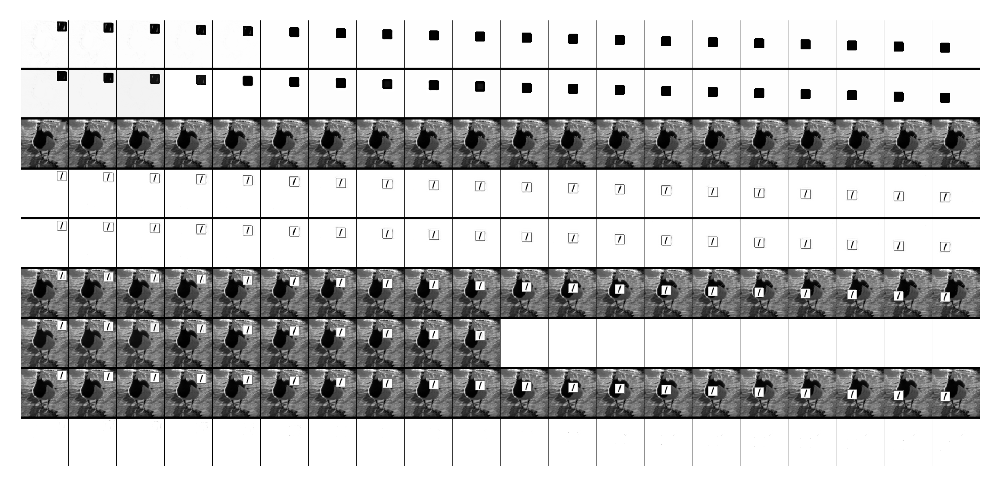

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


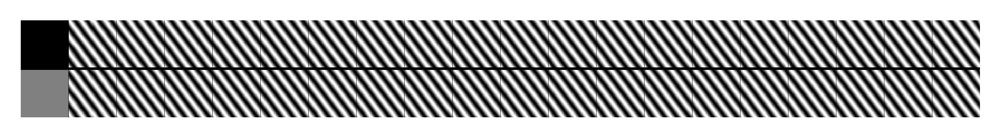

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.00012869897 0.9999778
Data[ 1 ]: min and max 0.007911323 1.0
Data[ 2 ]: min and max 0.0 0.9999659
Data[ 3 ]: min and max 0.0 0.99957037
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.2437049


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


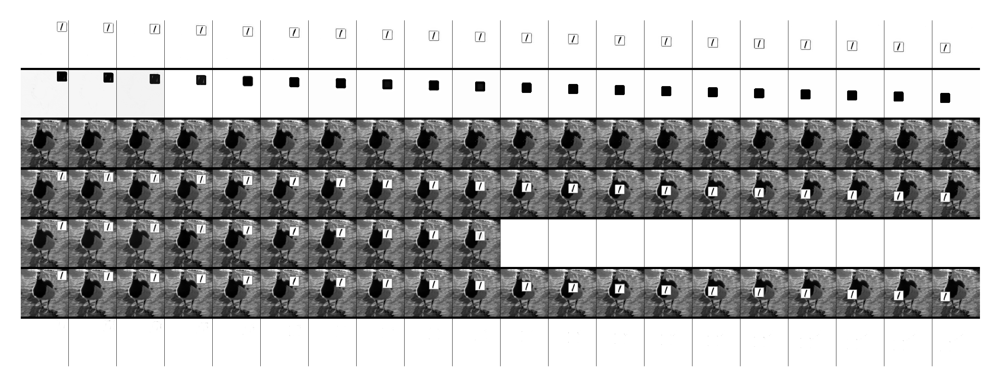

Data: min and max 0.0 0.9999659
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


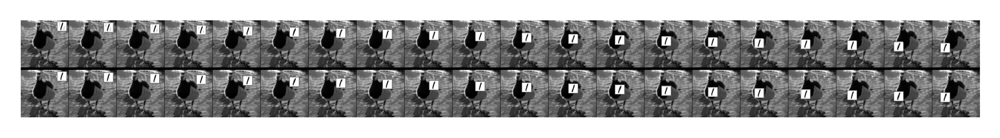

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


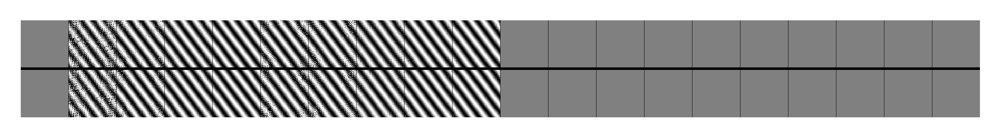

Data: min and max 0.006692851 1.0


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.9933071


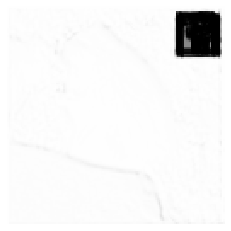

Data: min and max 0.042543434 0.95706904


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.04293096 0.9574566


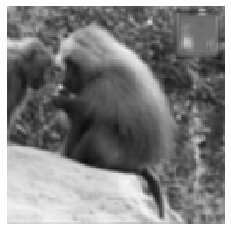

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


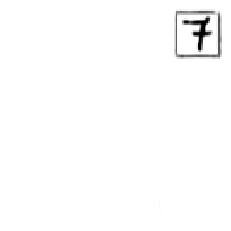

Data: min and max -1.0 0.9999999
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


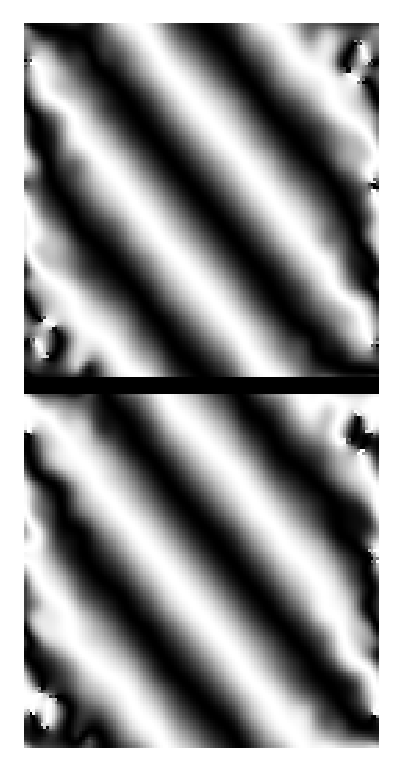

Velocity: tensor([[[ 2.0000, -2.5000]]], dtype=torch.float64)
Data: min and max 0.0008000775 1.0
Data[ 0 ]: min and max 0.00011188948 0.99997663
Data[ 1 ]: min and max 0.024674948 0.956831
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 0.99999994
Data[ 5 ]: min and max 0.0 0.99985623
Data[ 6 ]: min and max 0.0 0.99607843
Data[ 7 ]: min and max 0.0 0.28319108


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


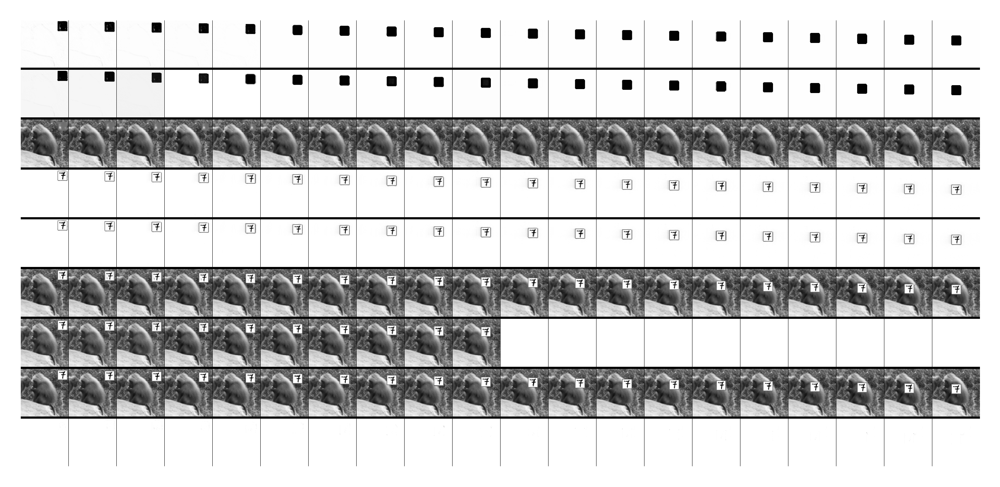

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


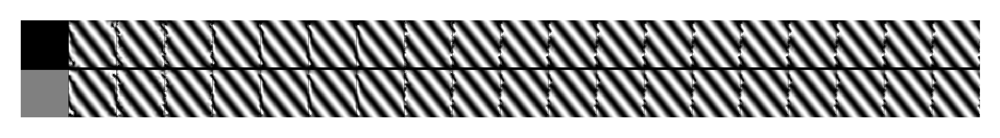

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.00011188948 0.99997663
Data[ 1 ]: min and max 0.024674948 0.956831
Data[ 2 ]: min and max 0.0 0.99999994
Data[ 3 ]: min and max 0.0 0.99985623
Data[ 4 ]: min and max 0.0 0.99607843
Data[ 5 ]: min and max 0.0 0.28319108


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


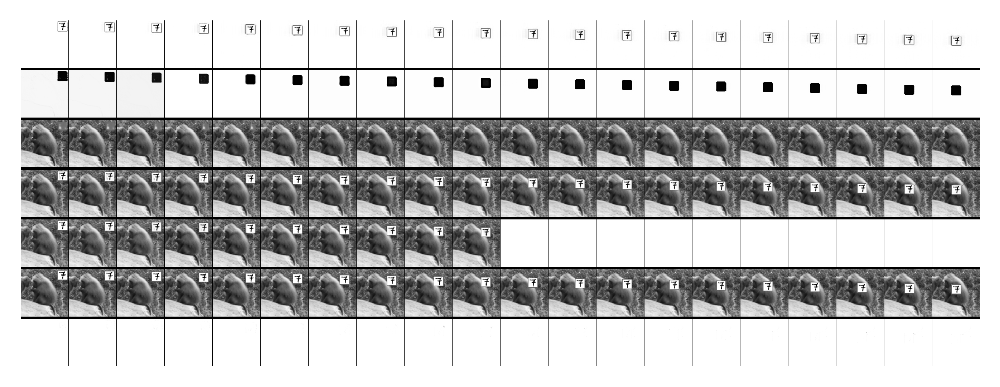

Data: min and max 0.0 0.99999994
Data[ 0 ]: min and max 0.0 0.99607843


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


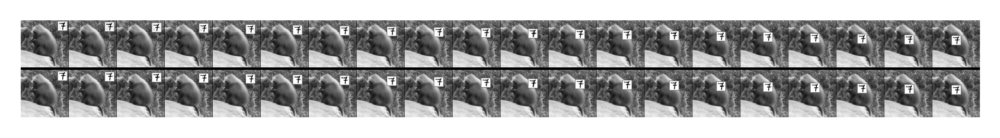

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -0.99999994 0.99999994


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


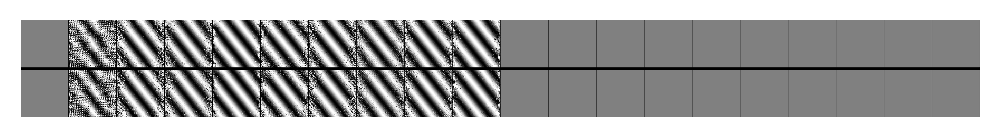

Data: min and max 0.006692851 0.9999964


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 3.5762787e-06 0.9933071


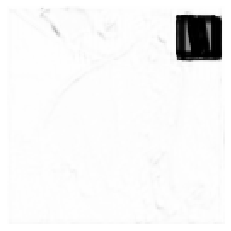

Data: min and max 0.0 0.9770811


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.02291888 1.0


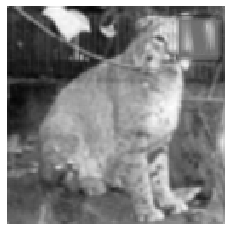

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


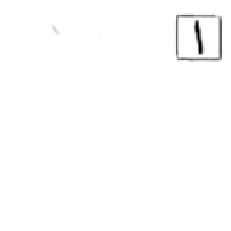

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -0.9999998 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


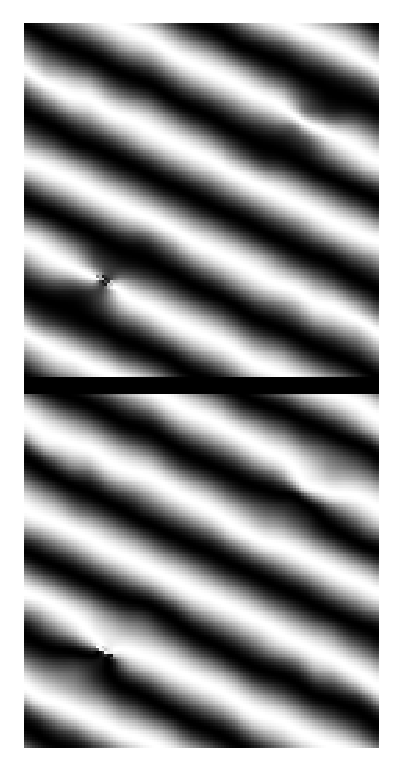

Velocity: tensor([[[ 4., -2.]]], dtype=torch.float64)
Data: min and max 0.0060795937 0.9999964
Data[ 0 ]: min and max 0.0001183538 0.9999783
Data[ 1 ]: min and max 0.009860072 0.9899735
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 0.9999548
Data[ 5 ]: min and max 0.0 0.9998184
Data[ 6 ]: min and max 0.0 0.99607843
Data[ 7 ]: min and max 0.0 0.37028104


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


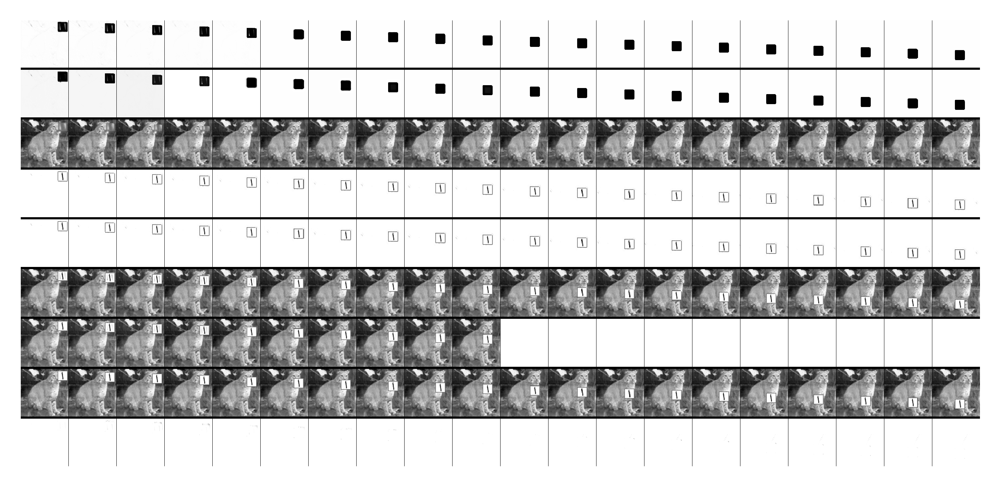

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


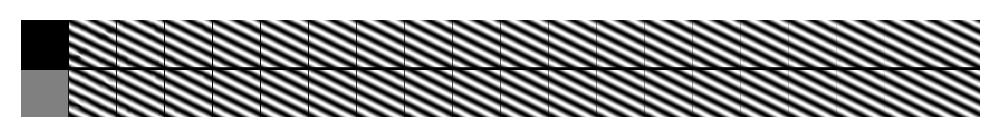

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.0001183538 0.9999783
Data[ 1 ]: min and max 0.009860072 0.9899735
Data[ 2 ]: min and max 0.0 0.9999548
Data[ 3 ]: min and max 0.0 0.9998184
Data[ 4 ]: min and max 0.0 0.99607843
Data[ 5 ]: min and max 0.0 0.37028104


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


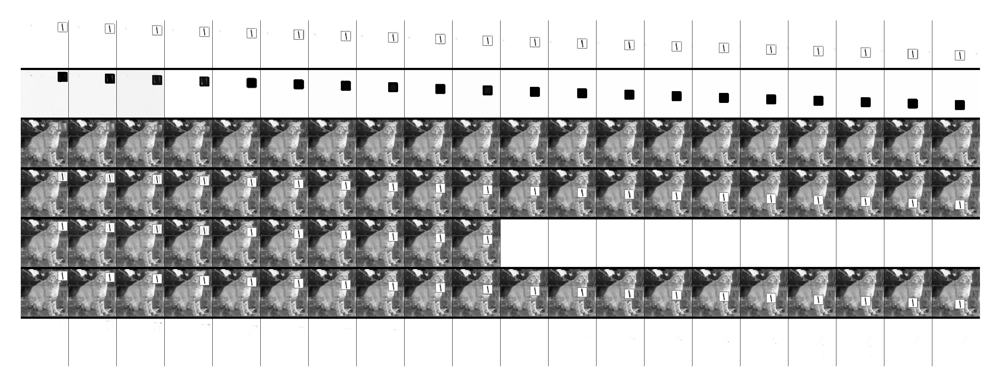

Data: min and max 0.0 0.9999548
Data[ 0 ]: min and max 0.0 0.99607843


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


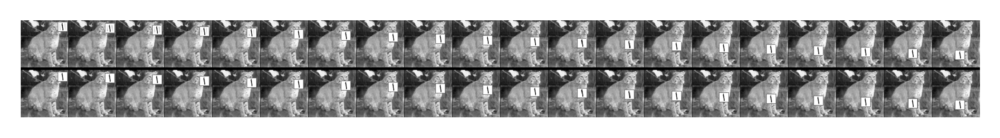

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


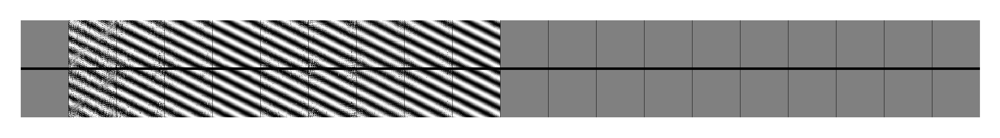

Data: min and max 0.006692851 1.0


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.9933071


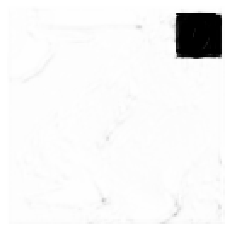

Data: min and max 0.038678363 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.96132165


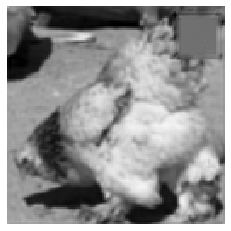

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


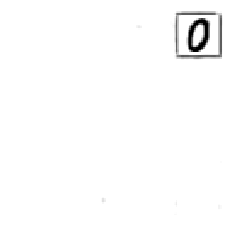

Data: min and max -0.99999994 1.0
Data[ 0 ]: min and max -0.9999998 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 0.9999999701976776


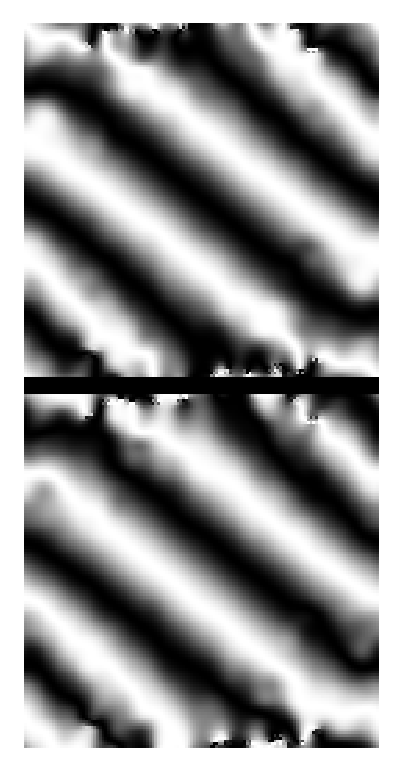

Velocity: tensor([[[ 2.5000, -2.0000]]], dtype=torch.float64)
Data: min and max 0.0010048274 1.0
Data[ 0 ]: min and max 1.4668925e-05 0.9999759
Data[ 1 ]: min and max 0.029603042 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.999881
Data[ 6 ]: min and max 0.0 0.99803925
Data[ 7 ]: min and max 0.0 0.30200553


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


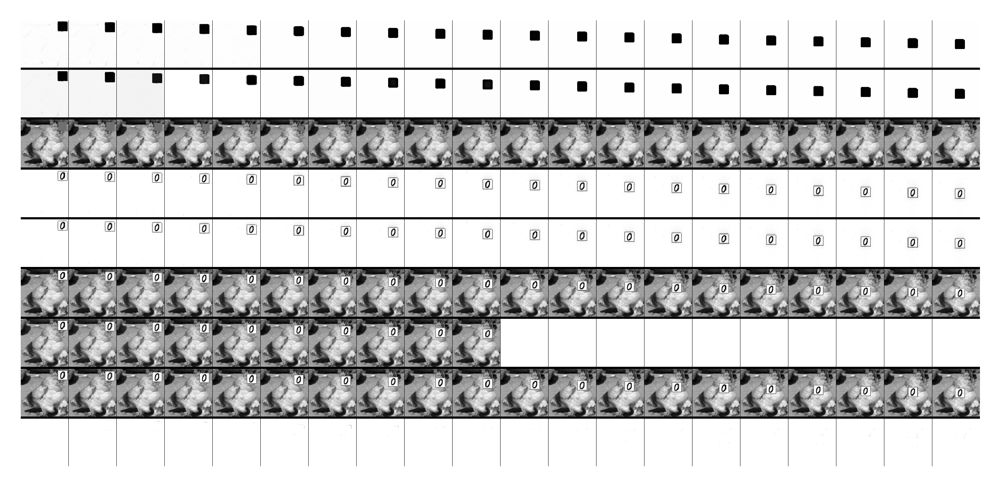

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


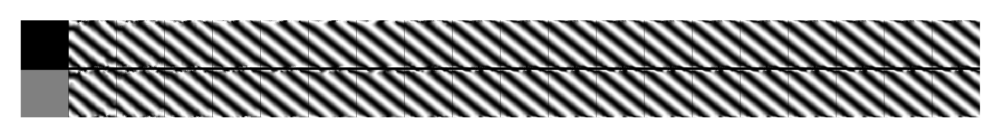

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 1.4668925e-05 0.9999759
Data[ 1 ]: min and max 0.029603042 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 0.999881
Data[ 4 ]: min and max 0.0 0.99803925
Data[ 5 ]: min and max 0.0 0.30200553


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


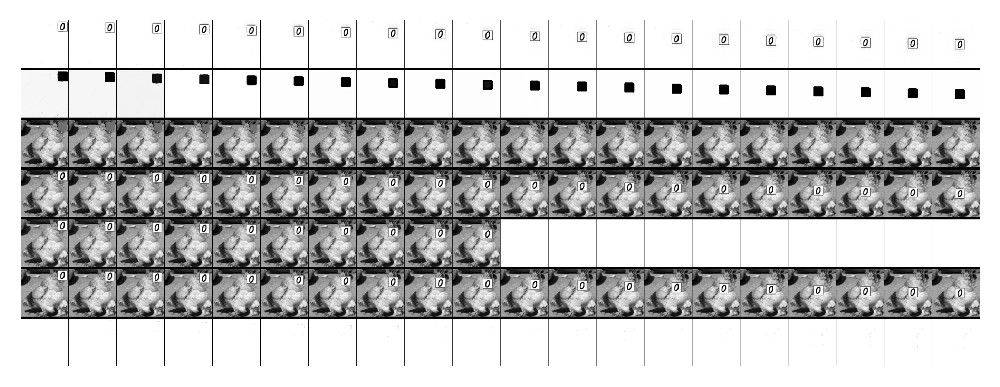

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.0 0.99803925


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


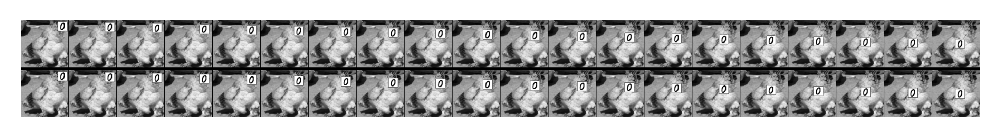

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


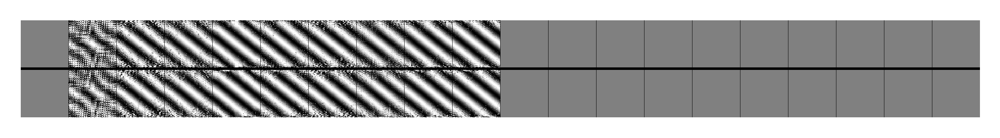

Data: min and max 0.006692851 0.999997


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 2.9802322e-06 0.9933071


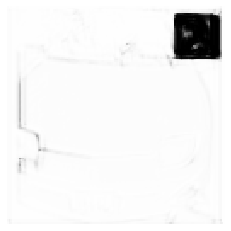

Data: min and max 0.026649974 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.97335005


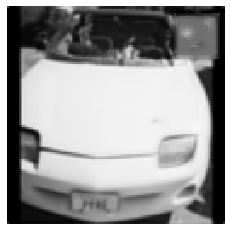

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


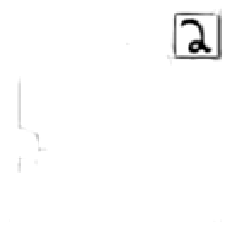

Data: min and max -0.9999994 0.99999994
Data[ 0 ]: min and max -0.99999994 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 0.9999999701976776


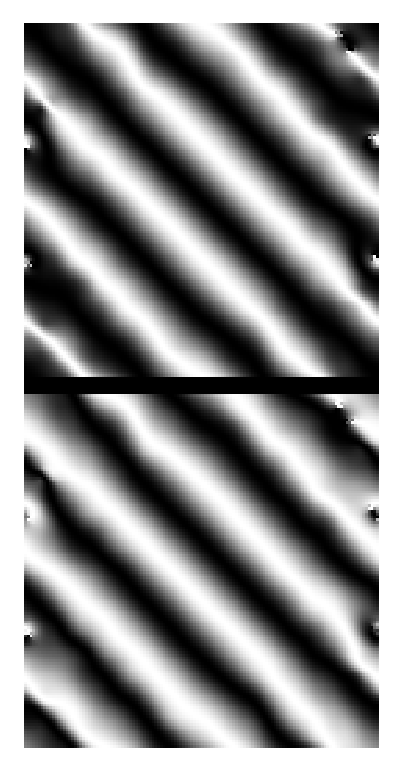

Velocity: tensor([[[ 3., -3.]]], dtype=torch.float64)
Data: min and max 0.0059735565 0.999997
Data[ 0 ]: min and max 6.409618e-05 0.9999778
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 1.6683041e-06 0.99995464
Data[ 5 ]: min and max 0.0 0.99985534
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.41557407


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


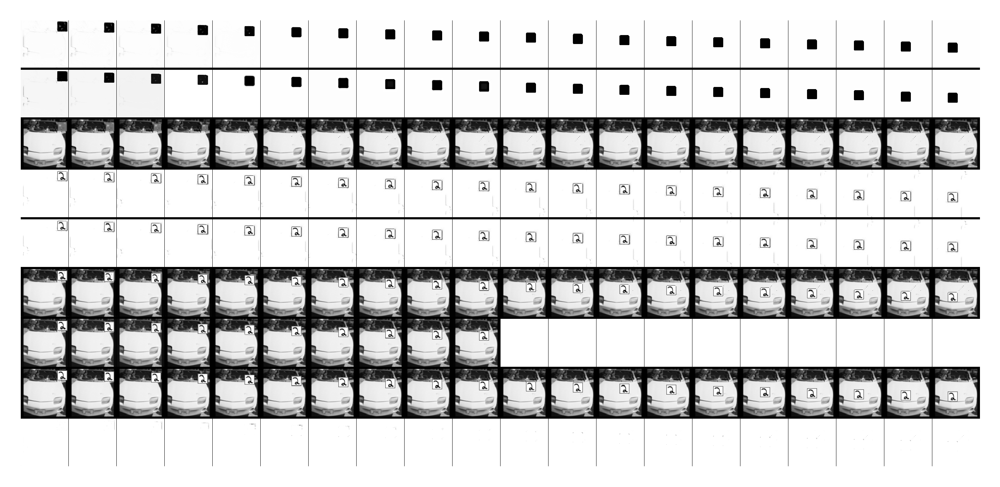

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


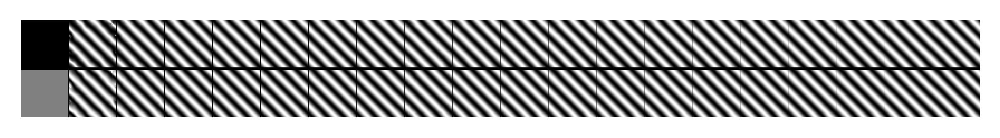

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 6.409618e-05 0.9999778
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 1.6683041e-06 0.99995464
Data[ 3 ]: min and max 0.0 0.99985534
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.41557407


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


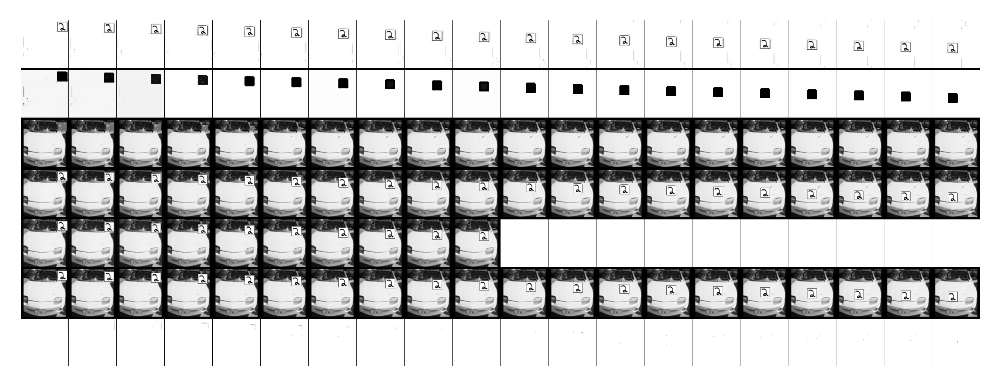

Data: min and max 1.6683041e-06 0.99995464
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


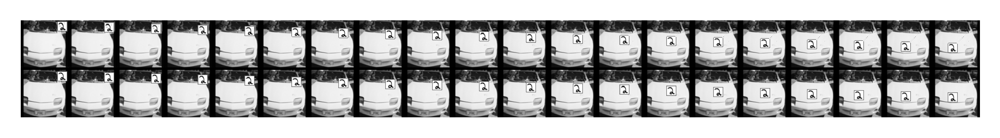

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


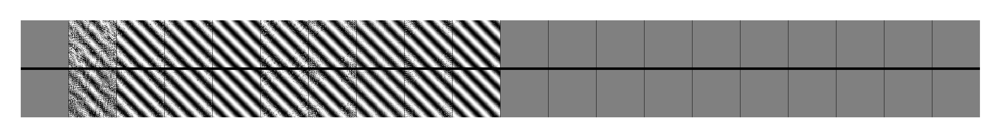

Data: min and max 0.006692851 1.0


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.9933071


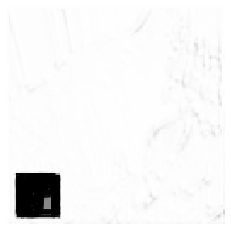

Data: min and max 0.038658895 0.9271414


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.07285857 0.96134114


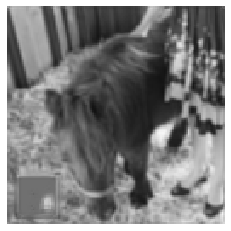

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


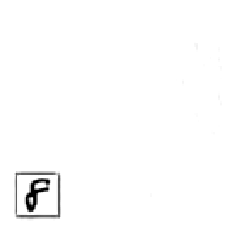

Data: min and max -1.0 0.9999999
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


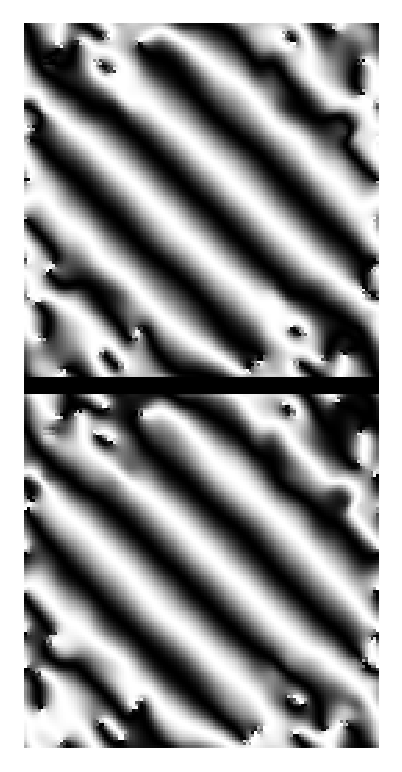

Velocity: tensor([[[-3.5000,  3.5000]]], dtype=torch.float64)
Data: min and max 0.000948103 1.0
Data[ 0 ]: min and max 0.00013380287 0.99997485
Data[ 1 ]: min and max 0.030583182 0.9436172
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.9999086
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.24010159


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


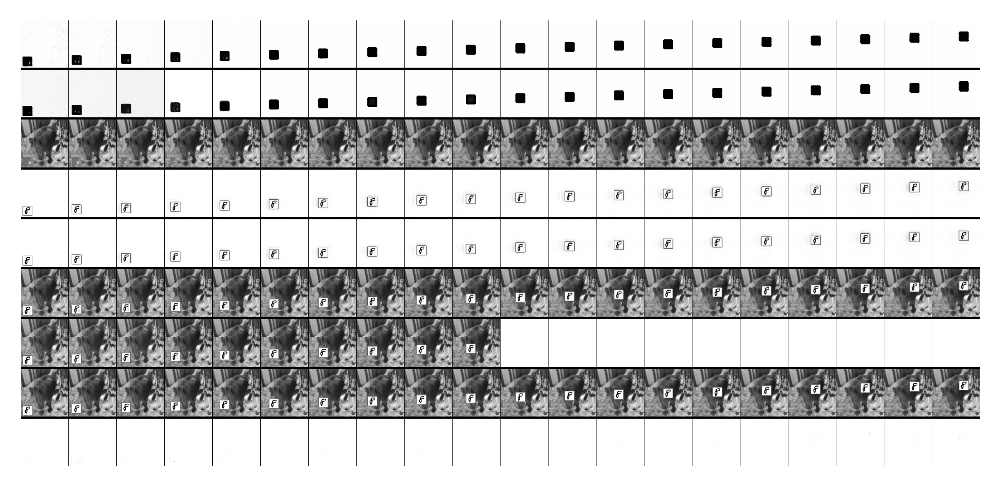

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


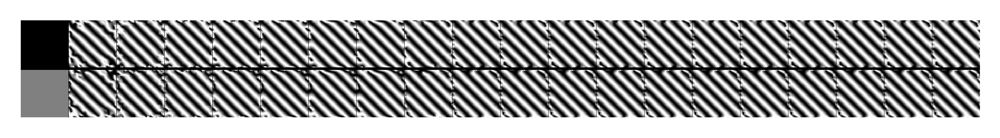

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.00013380287 0.99997485
Data[ 1 ]: min and max 0.030583182 0.9436172
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 0.9999086
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.24010159


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


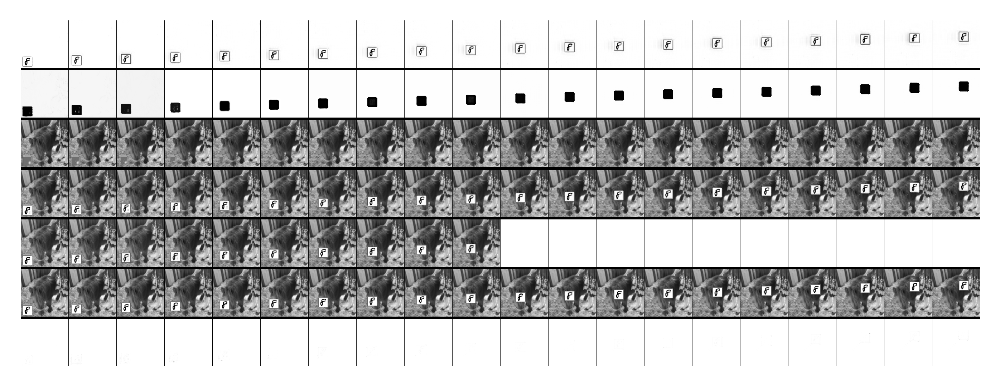

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


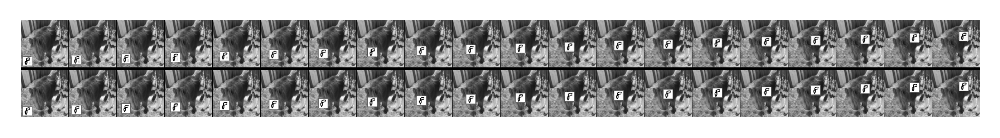

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


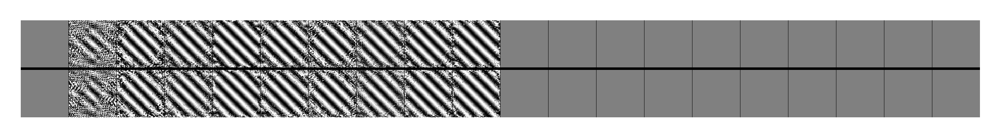

Data: min and max 0.006692851 1.0


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.9933071


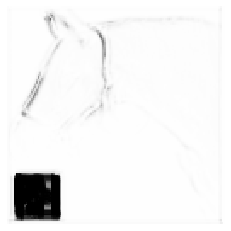

Data: min and max 0.034340024 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.96566


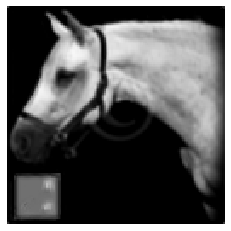

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


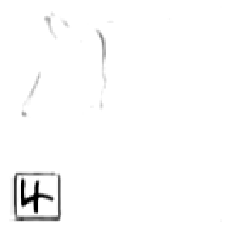

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 0.9999999


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


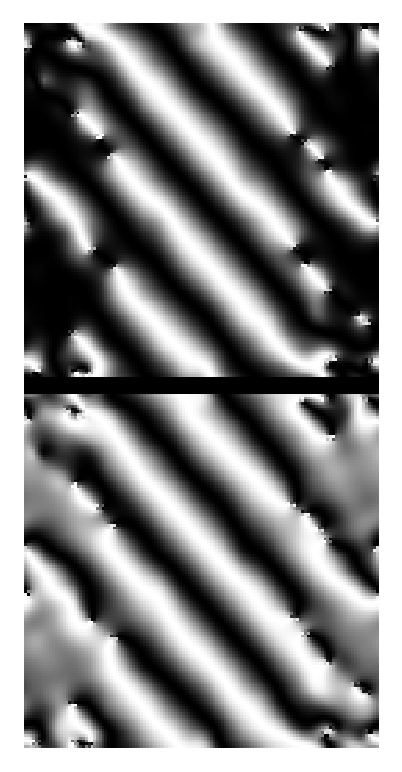

Velocity: tensor([[[-3.0000,  3.5000]]], dtype=torch.float64)
Data: min and max 0.001114384 1.0
Data[ 0 ]: min and max 2.2670252e-05 0.9999783
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.9999256
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.6487591


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


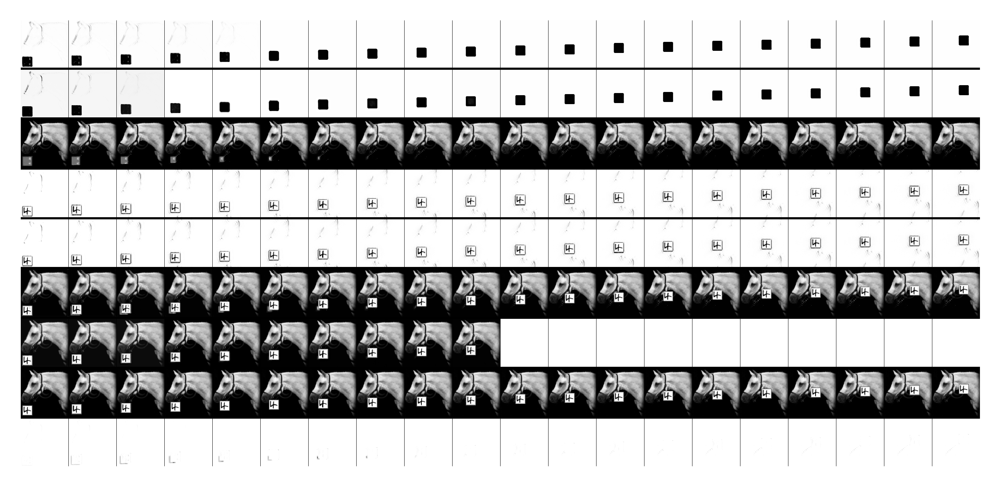

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


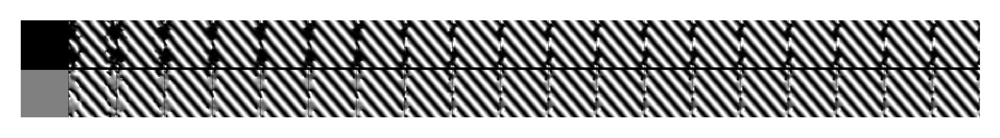

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 2.2670252e-05 0.9999783
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 0.9999256
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.6487591


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


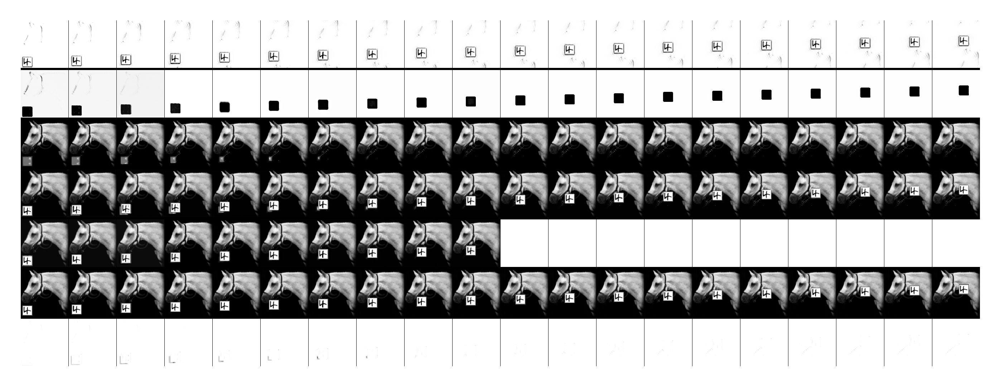

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


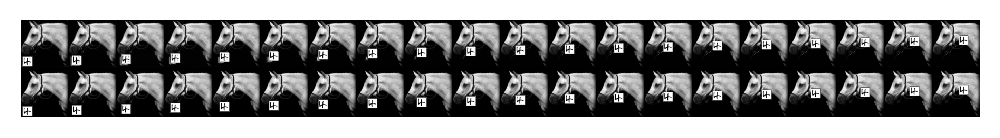

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


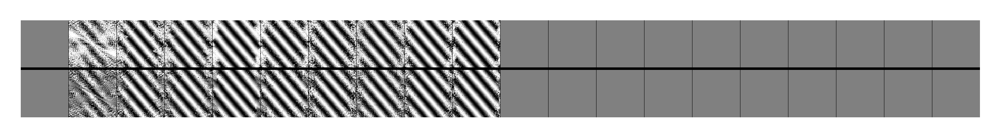

Data: min and max 0.006692851 1.0


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.9933071


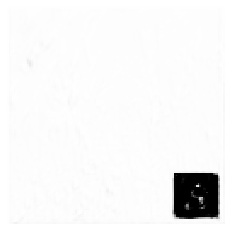

Data: min and max 0.12116225 0.9752867


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.024713278 0.87883776


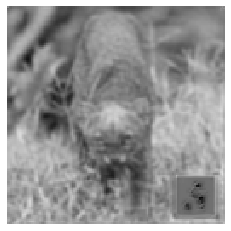

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


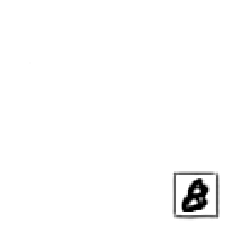

Data: min and max -0.99999994 0.9999999
Data[ 0 ]: min and max -0.99999994 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 0.9999999701976776


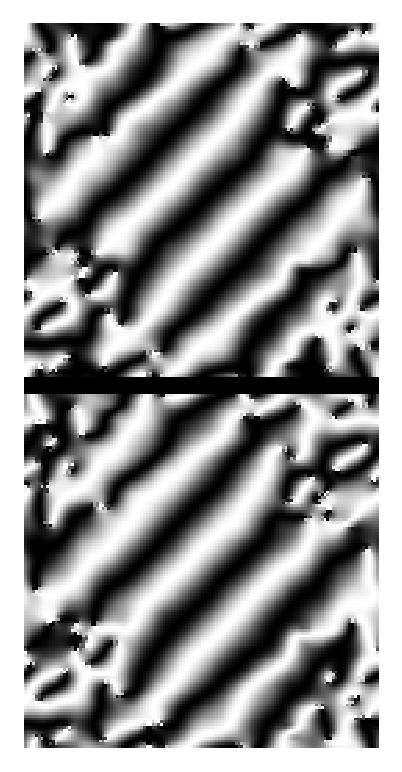

Velocity: tensor([[[-3.5000, -3.5000]]], dtype=torch.float64)
Data: min and max 0.00062633114 1.0
Data[ 0 ]: min and max 0.0001389176 0.9999739
Data[ 1 ]: min and max 0.12140118 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 0.9999992
Data[ 5 ]: min and max 0.0 0.9999193
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.48229933


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


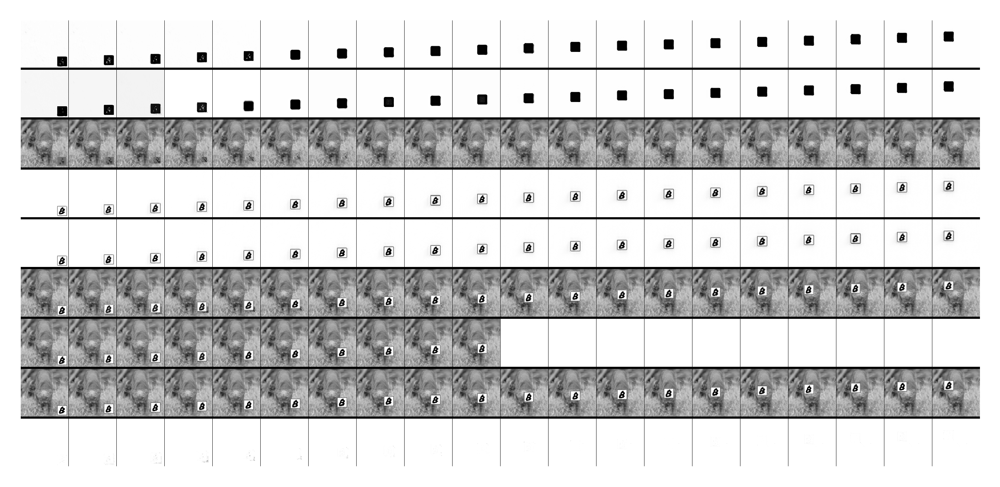

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


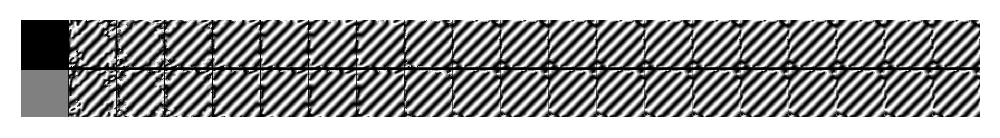

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.0001389176 0.9999739
Data[ 1 ]: min and max 0.12140118 1.0
Data[ 2 ]: min and max 0.0 0.9999992
Data[ 3 ]: min and max 0.0 0.9999193
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.48229933


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


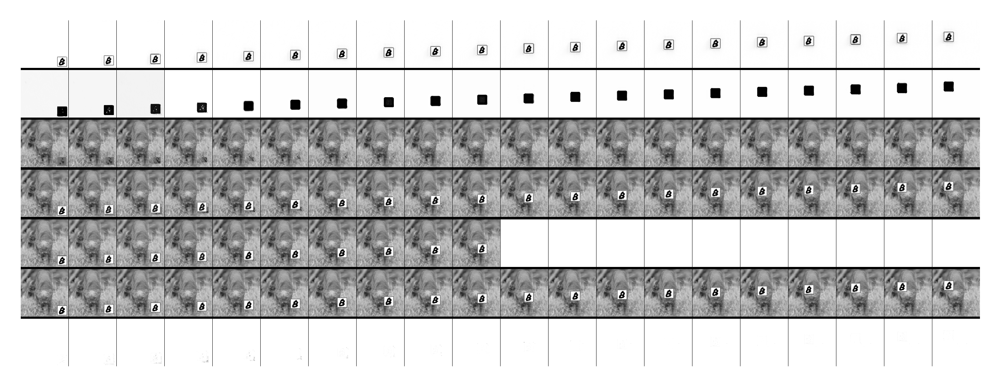

Data: min and max 0.0 0.9999992
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


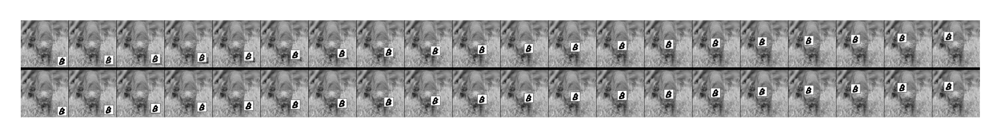

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


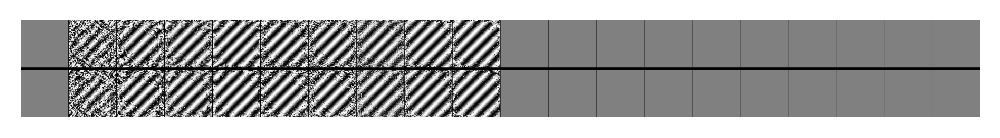

Data: min and max 0.006692851 1.0


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.9933071


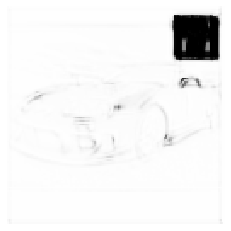

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


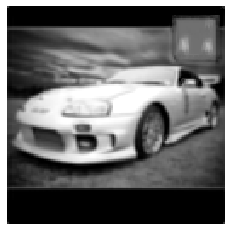

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


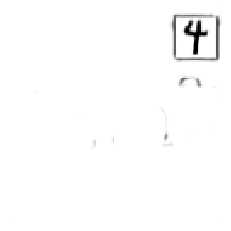

Data: min and max -0.9999987 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


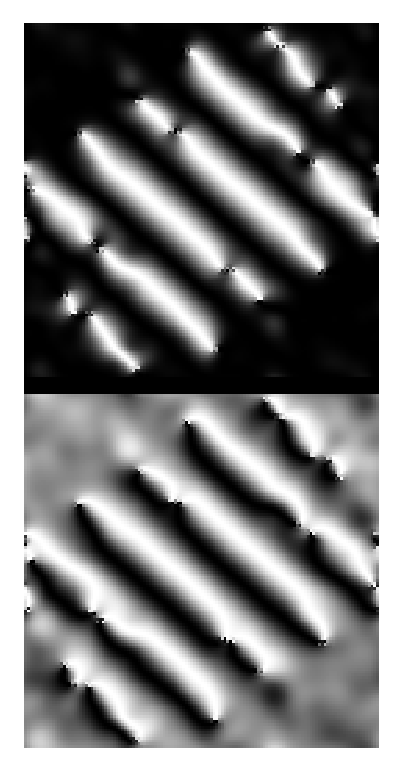

Velocity: tensor([[[ 4.0000, -3.5000]]], dtype=torch.float64)
Data: min and max 0.0011701756 1.0
Data[ 0 ]: min and max 0.00013242669 0.9999769
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.9997619
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.38906834


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


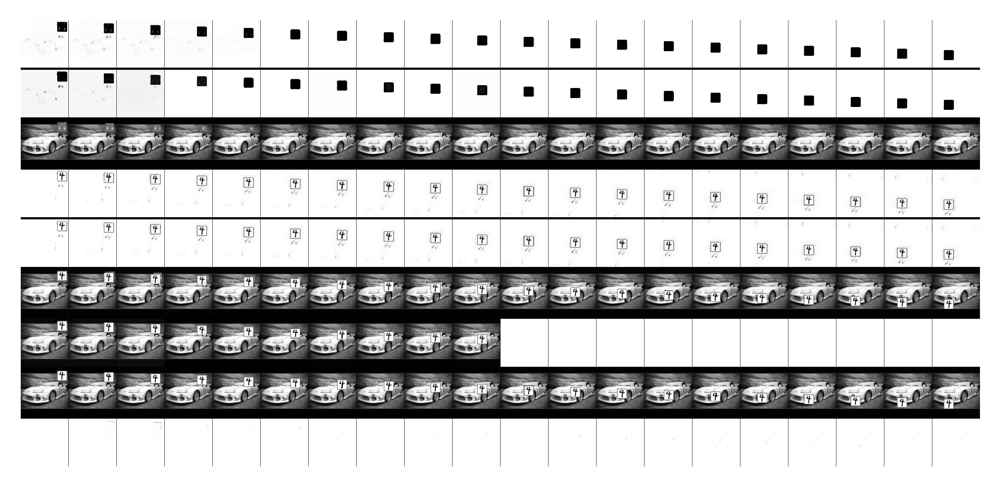

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


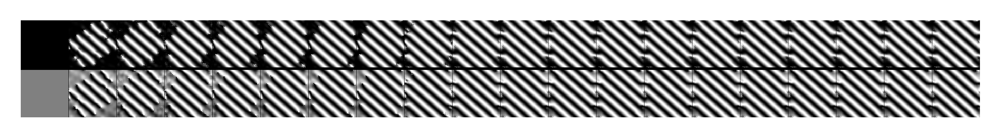

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.00013242669 0.9999769
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 0.9997619
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.38906834


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


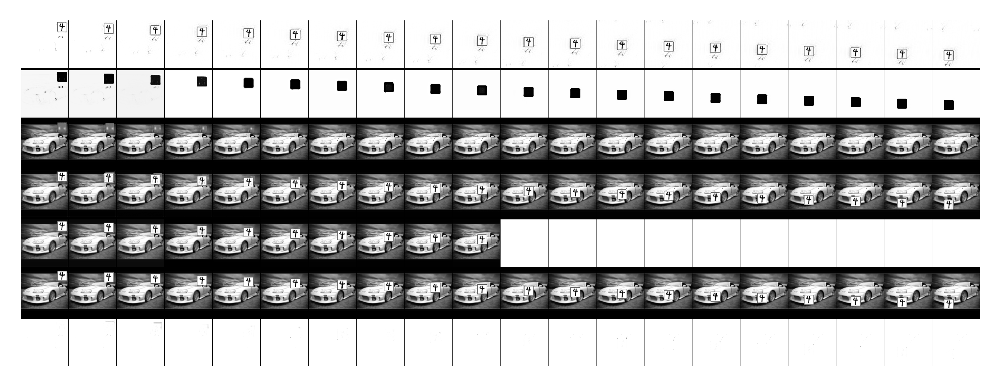

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


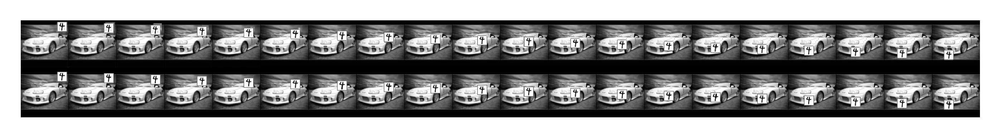

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


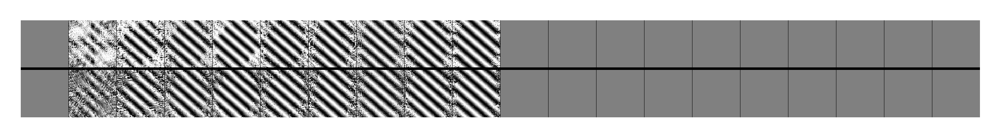

Data: min and max 0.006692851 0.9999999


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 1.1920929e-07 0.9933071


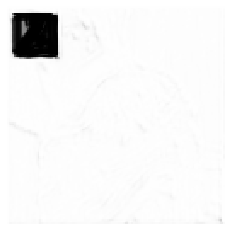

Data: min and max 0.0 0.9892904


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.010709584 1.0


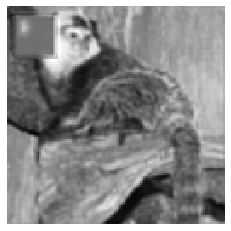

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


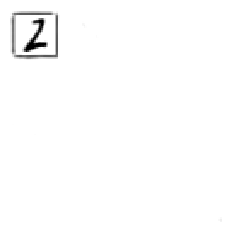

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


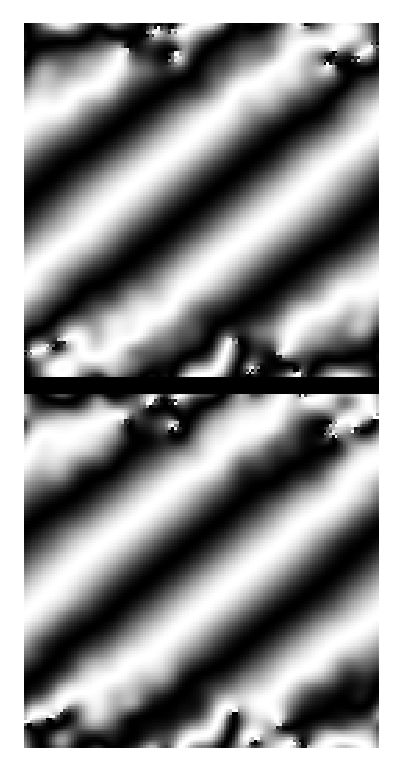

Velocity: tensor([[[2.5000, 2.0000]]], dtype=torch.float64)
Data: min and max 0.0013813693 0.9999999
Data[ 0 ]: min and max 2.5404066e-05 0.9999777
Data[ 1 ]: min and max 0.026834931 0.9976234
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 0.99999994
Data[ 5 ]: min and max 0.0 0.99947506
Data[ 6 ]: min and max 0.0 0.99607843
Data[ 7 ]: min and max 0.0 0.3374323


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


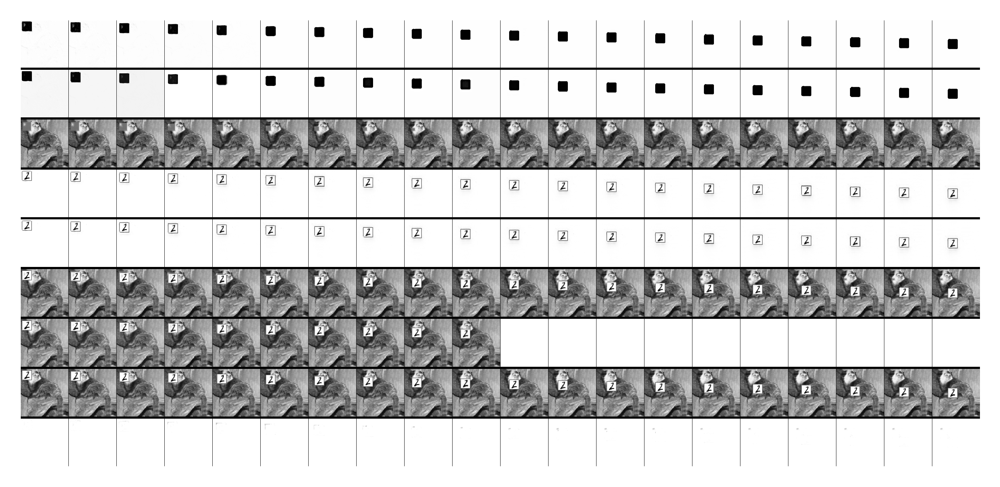

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


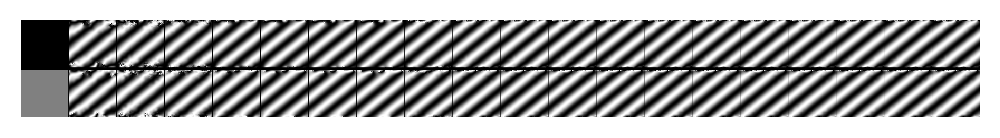

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 2.5404066e-05 0.9999777
Data[ 1 ]: min and max 0.026834931 0.9976234
Data[ 2 ]: min and max 0.0 0.99999994
Data[ 3 ]: min and max 0.0 0.99947506
Data[ 4 ]: min and max 0.0 0.99607843
Data[ 5 ]: min and max 0.0 0.3374323


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


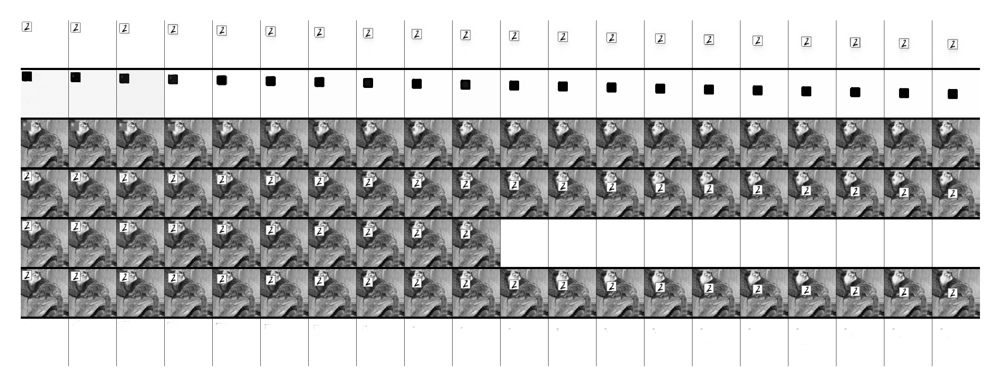

Data: min and max 0.0 0.99999994
Data[ 0 ]: min and max 0.0 0.99607843


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


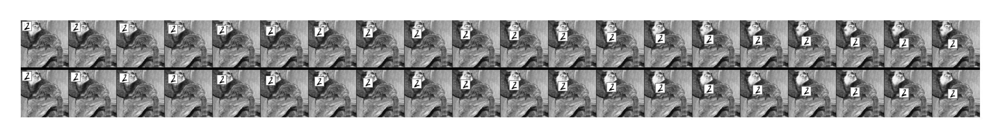

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


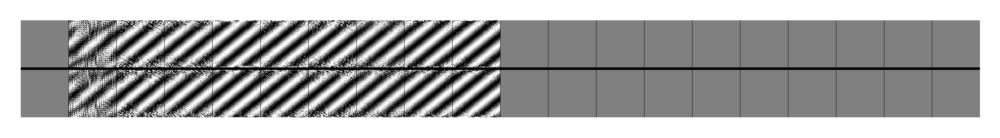

Data: min and max 0.006692851 0.99999976


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 2.3841858e-07 0.9933071


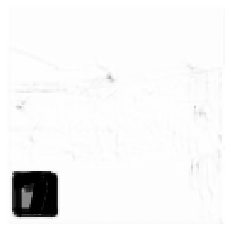

Data: min and max 0.07309689 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.9269031


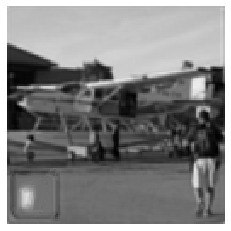

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


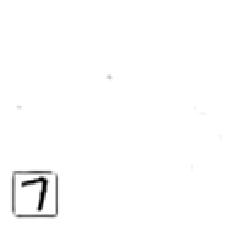

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


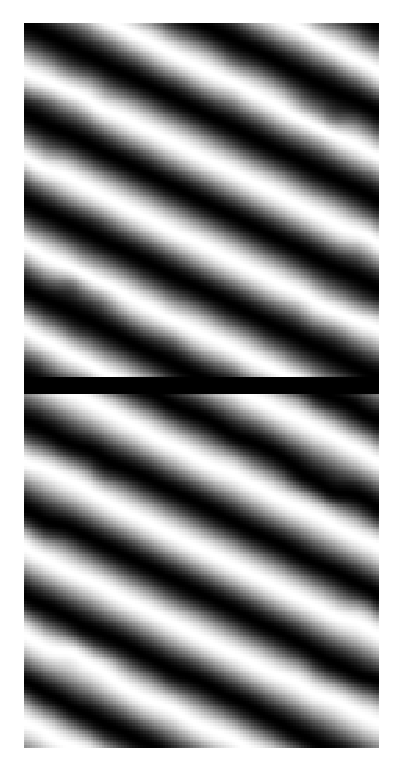

Velocity: tensor([[[-4.,  2.]]], dtype=torch.float64)
Data: min and max 0.005675737 0.99999976
Data[ 0 ]: min and max 0.00011772438 0.99997675
Data[ 1 ]: min and max 0.06713615 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 0.99475473
Data[ 4 ]: min and max 1.3760888e-07 0.99996525
Data[ 5 ]: min and max 0.0 0.99899167
Data[ 6 ]: min and max 0.0 0.9901961
Data[ 7 ]: min and max 0.0 0.26334205


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


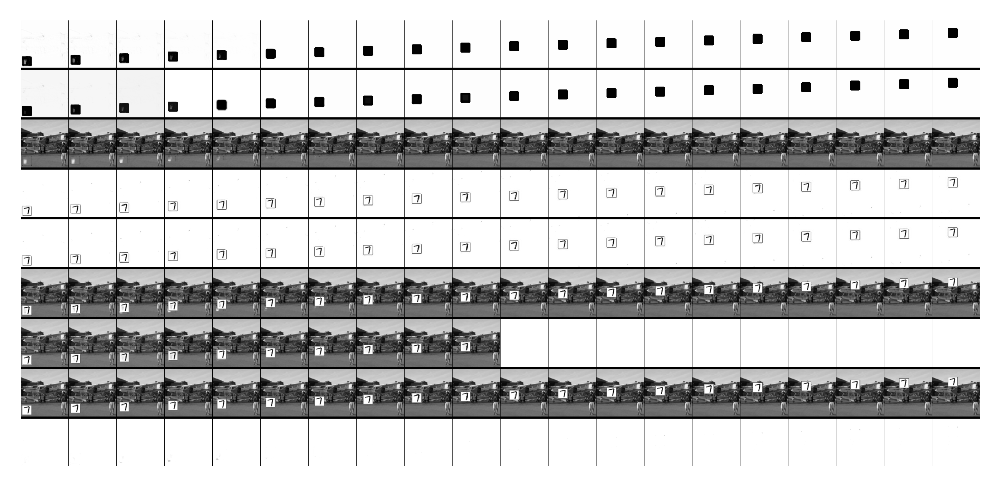

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


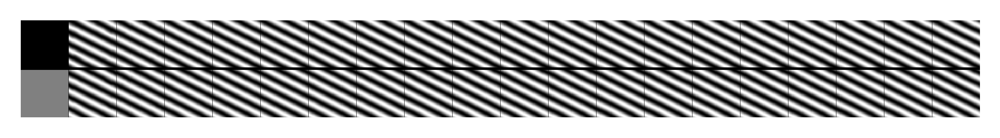

Data: min and max 0.0 0.99475473
Data[ 0 ]: min and max 0.00011772438 0.99997675
Data[ 1 ]: min and max 0.06713615 1.0
Data[ 2 ]: min and max 1.3760888e-07 0.99996525
Data[ 3 ]: min and max 0.0 0.99899167
Data[ 4 ]: min and max 0.0 0.9901961
Data[ 5 ]: min and max 0.0 0.26334205


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


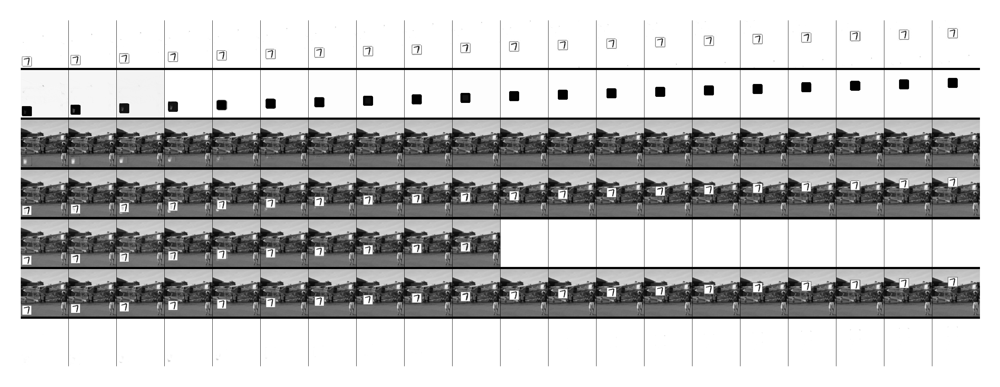

Data: min and max 1.3760888e-07 0.99996525
Data[ 0 ]: min and max 0.0 0.9901961


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


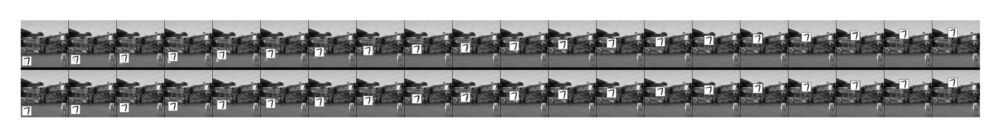

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


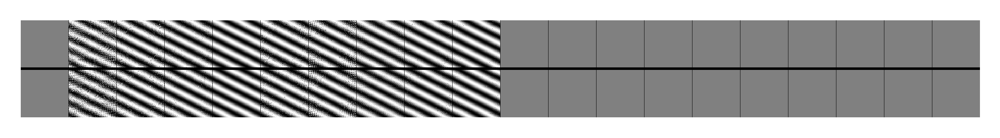

Data: min and max 0.006692851 0.9999987


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 1.3113022e-06 0.9933071


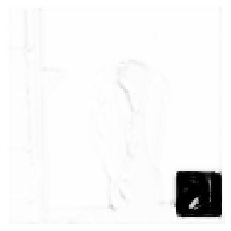

Data: min and max 0.037744947 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.96225506


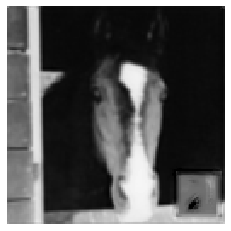

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


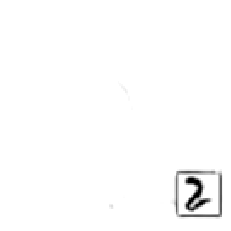

Data: min and max -0.9999998 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


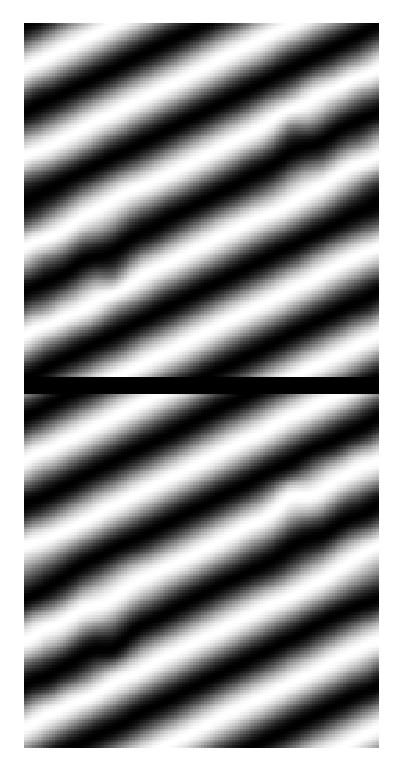

Velocity: tensor([[[-4., -2.]]], dtype=torch.float64)
Data: min and max 0.0055695 0.9999987
Data[ 0 ]: min and max 2.2326923e-05 0.99998
Data[ 1 ]: min and max 0.04564282 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 8.314806e-07 1.0
Data[ 5 ]: min and max 0.0 1.0
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.6794273


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


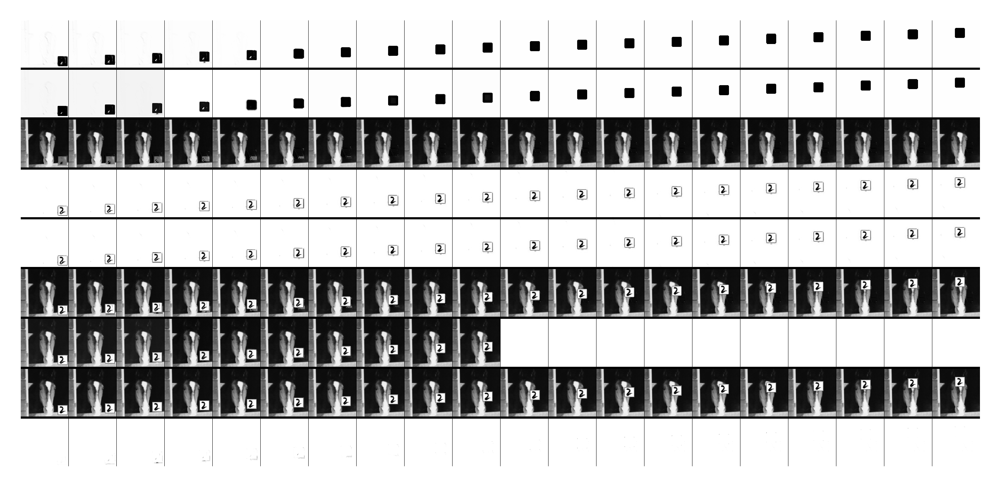

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


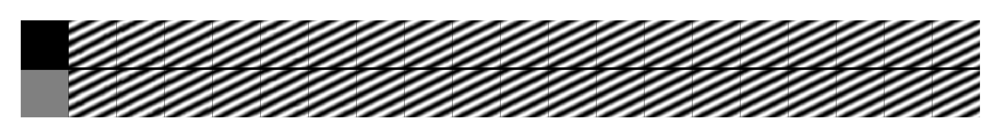

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 2.2326923e-05 0.99998
Data[ 1 ]: min and max 0.04564282 1.0
Data[ 2 ]: min and max 8.314806e-07 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.6794273


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


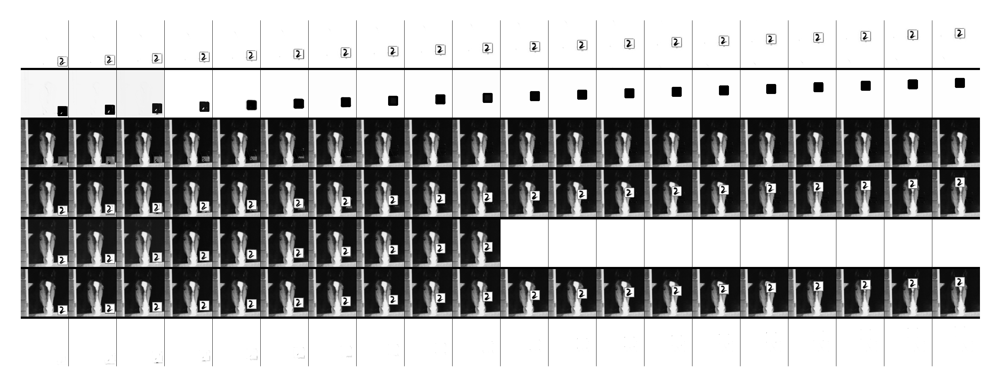

Data: min and max 8.314806e-07 1.0
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


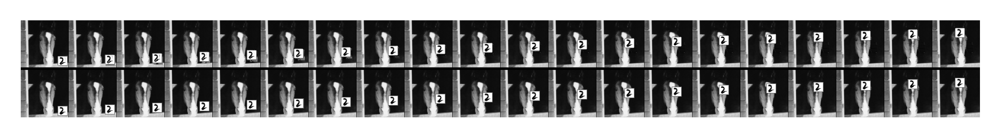

Data: min and max -1.0 0.99999994
Data[ 0 ]: min and max -0.99999994 0.99999994


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


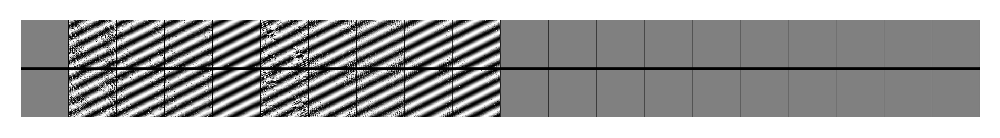

Data: min and max 0.006692851 0.9999999


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 1.1920929e-07 0.9933071


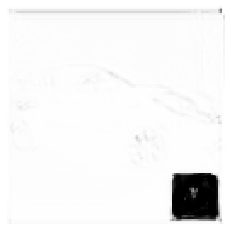

Data: min and max 0.031252474 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.9687475


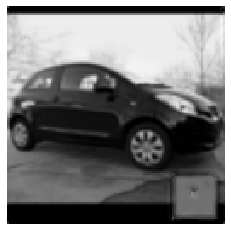

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


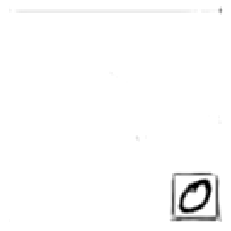

Data: min and max -0.99999994 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


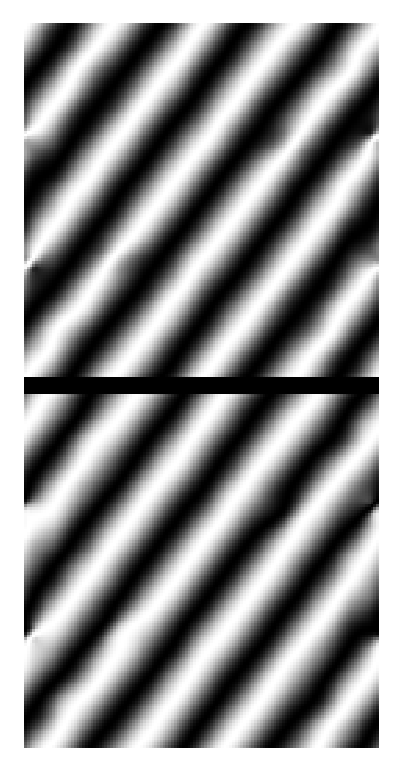

Velocity: tensor([[[-3., -4.]]], dtype=torch.float64)
Data: min and max 0.006000774 0.9999999
Data[ 0 ]: min and max 4.3928736e-05 0.9999784
Data[ 1 ]: min and max 0.027642803 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 3.4220588e-07 0.99998873
Data[ 5 ]: min and max 0.0 0.99996924
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.2411657


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


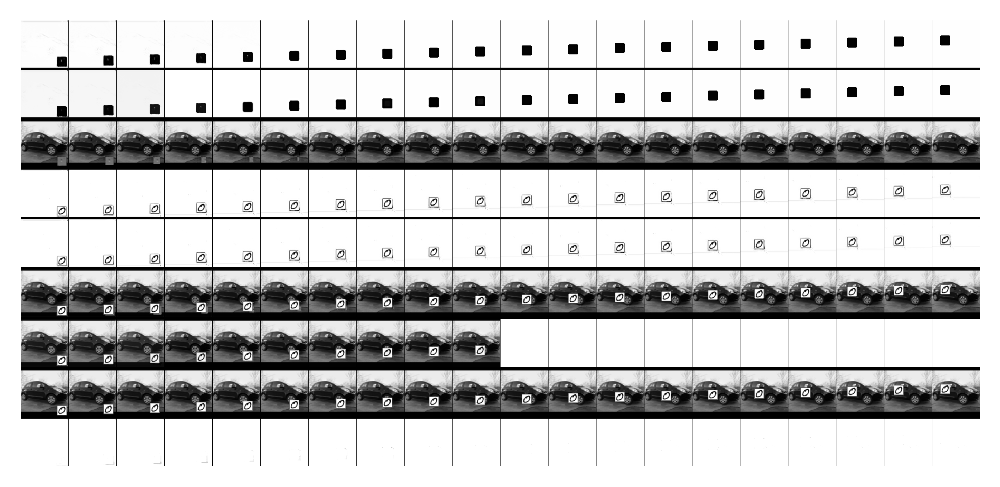

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


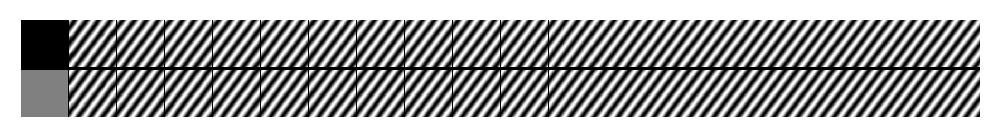

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 4.3928736e-05 0.9999784
Data[ 1 ]: min and max 0.027642803 1.0
Data[ 2 ]: min and max 3.4220588e-07 0.99998873
Data[ 3 ]: min and max 0.0 0.99996924
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.2411657


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


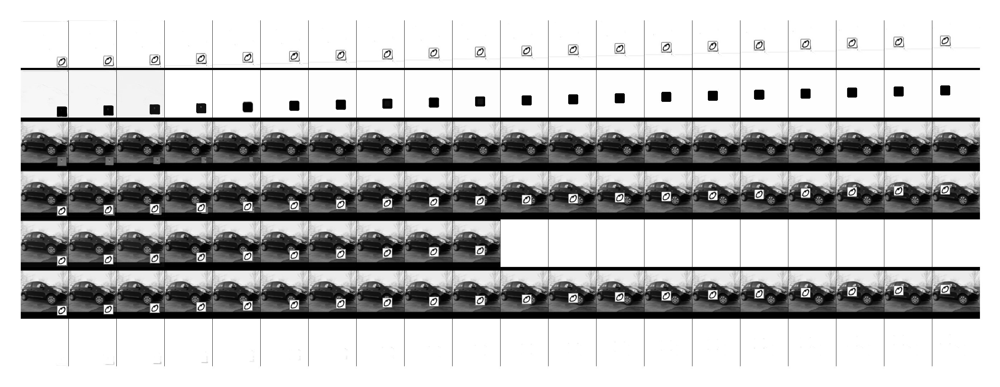

Data: min and max 3.4220588e-07 0.99998873
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


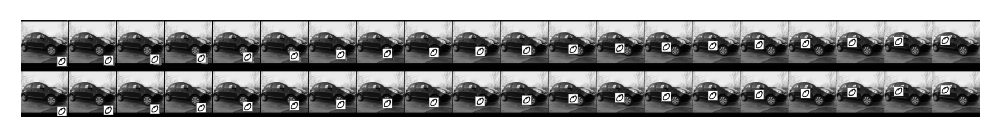

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


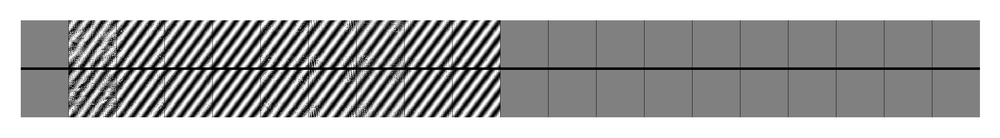

Data: min and max 0.006692851 0.99999845


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 1.5497208e-06 0.9933071


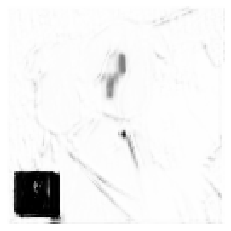

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


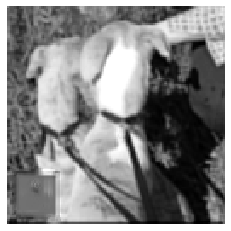

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


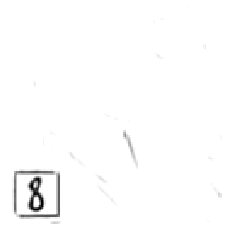

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -0.99999994 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


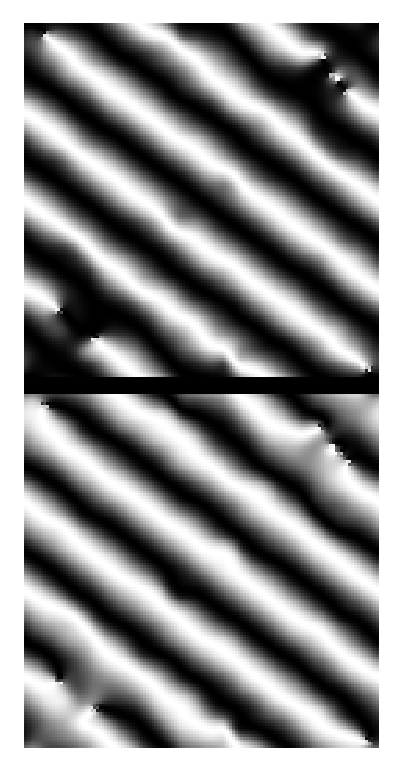

Velocity: tensor([[[-4.,  3.]]], dtype=torch.float64)
Data: min and max 0.005706266 0.99999845
Data[ 0 ]: min and max 0.000118129195 0.99997807
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 0.0 0.99998707
Data[ 5 ]: min and max 0.0 0.9992628
Data[ 6 ]: min and max 0.0 0.9901961
Data[ 7 ]: min and max 0.0 0.38882762


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


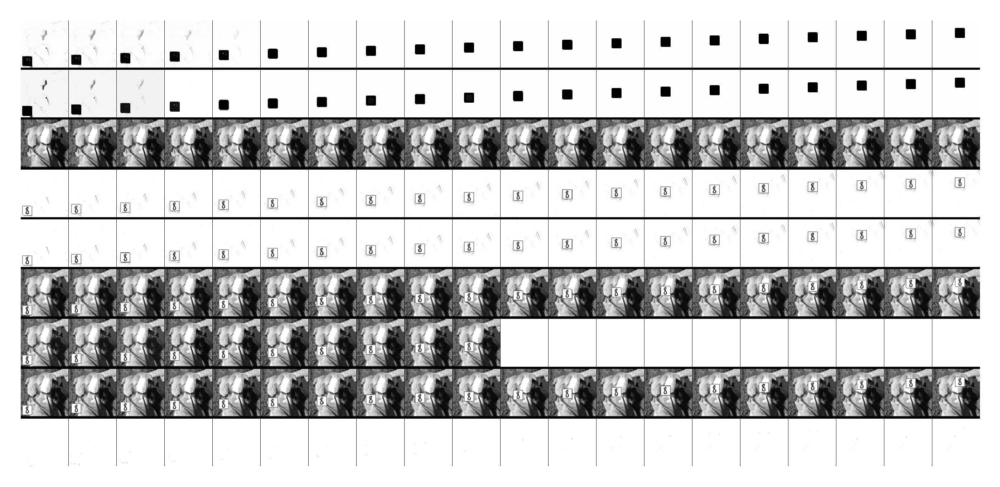

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


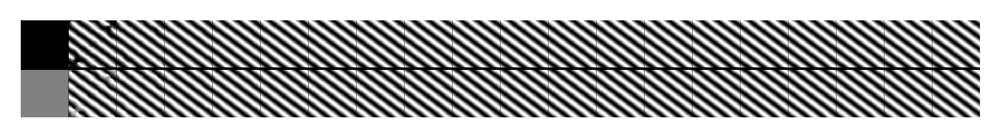

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 0.000118129195 0.99997807
Data[ 1 ]: min and max 0.0 1.0
Data[ 2 ]: min and max 0.0 0.99998707
Data[ 3 ]: min and max 0.0 0.9992628
Data[ 4 ]: min and max 0.0 0.9901961
Data[ 5 ]: min and max 0.0 0.38882762


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


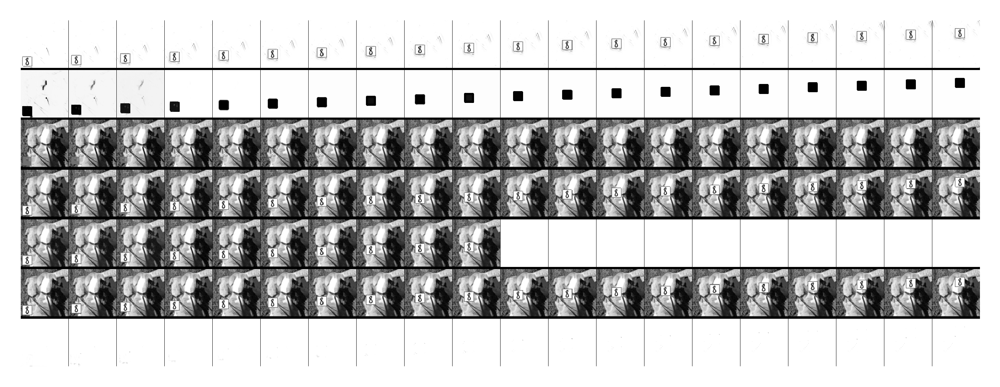

Data: min and max 0.0 0.99998707
Data[ 0 ]: min and max 0.0 0.9901961


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


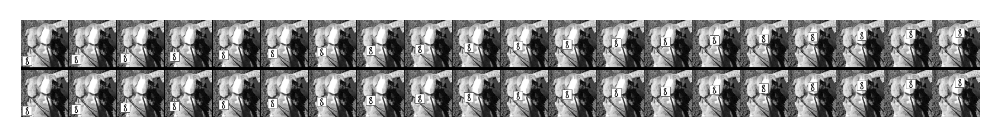

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


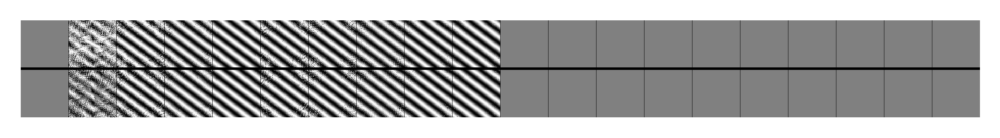

Data: min and max 0.006692851 0.9999999


<b><span style="color: #ff0000">AInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 1.1920929e-07 0.9933071


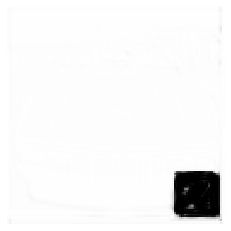

Data: min and max 0.3882498 1.0


<b><span style="color: #ff0000">BGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 0.6117502


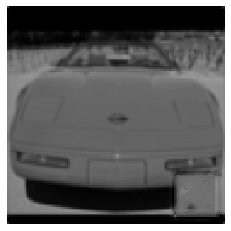

Data: min and max 0.0 1.0


<b><span style="color: #ff0000">FGInit -1 (r)</span></b>  (1, 1, 128, 128, 1)

Image: min and max 0.0 1.0


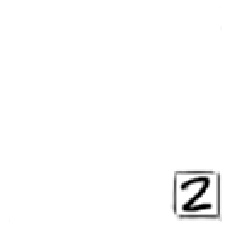

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TInit R&I 1 (N) (r)</span></b>  (1, 1, 262, 128, 1)

Image: min and max 0.0 1.0


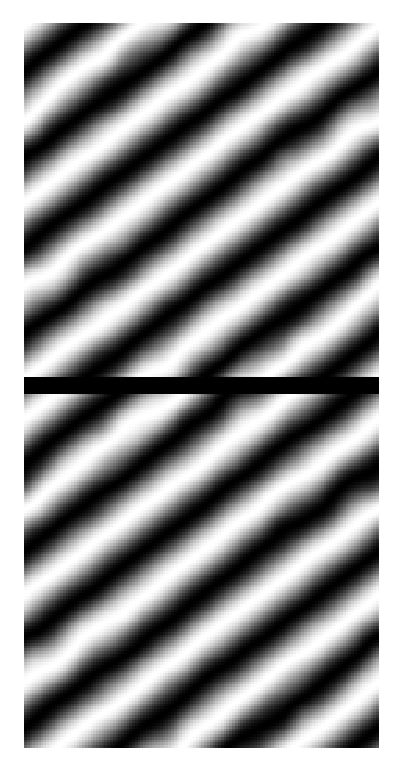

Velocity: tensor([[[-4., -3.]]], dtype=torch.float64)
Data: min and max 0.0060957964 0.9999999
Data[ 0 ]: min and max 7.113979e-05 0.9999794
Data[ 1 ]: min and max 0.38994753 1.0
Data[ 2 ]: min and max 0.0 1.0
Data[ 3 ]: min and max 0.0 1.0
Data[ 4 ]: min and max 6.889269e-08 0.9999987
Data[ 5 ]: min and max 0.0 0.9998879
Data[ 6 ]: min and max 0.0 1.0
Data[ 7 ]: min and max 0.0 0.23940346


<b><span style="color: #ff0000">NA,NAU,BG,NFG,NFGU,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 1200, 128, 1)

Image: min and max 0.0 1.0


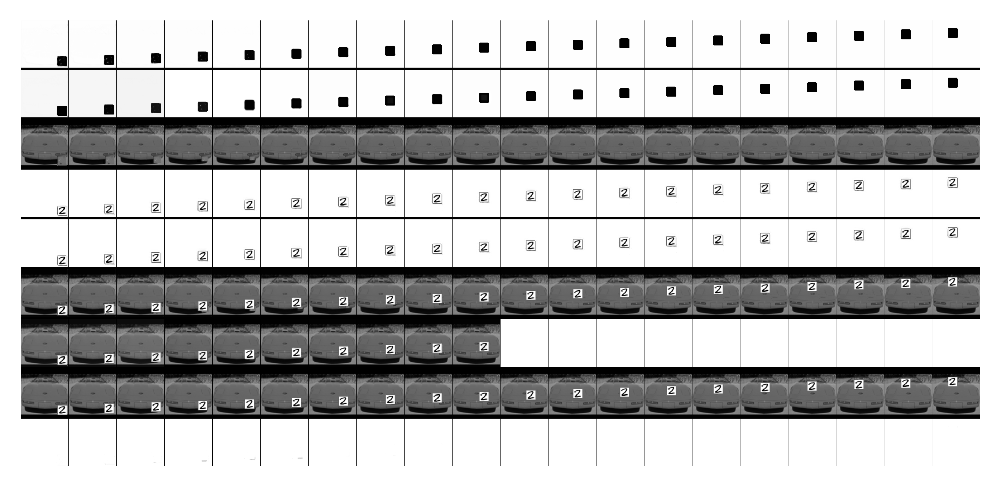

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


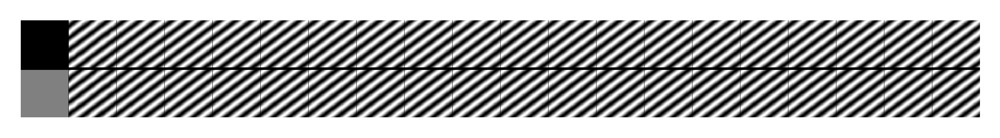

Data: min and max 0.0 1.0
Data[ 0 ]: min and max 7.113979e-05 0.9999794
Data[ 1 ]: min and max 0.38994753 1.0
Data[ 2 ]: min and max 6.889269e-08 0.9999987
Data[ 3 ]: min and max 0.0 0.9998879
Data[ 4 ]: min and max 0.0 1.0
Data[ 5 ]: min and max 0.0 0.23940346


<b><span style="color: #ff0000">NFGU,NAU,BG,Pred,Cor,GT,L2 (r)</span></b>  (1, 20, 932, 128, 1)

Image: min and max 0.0 1.0


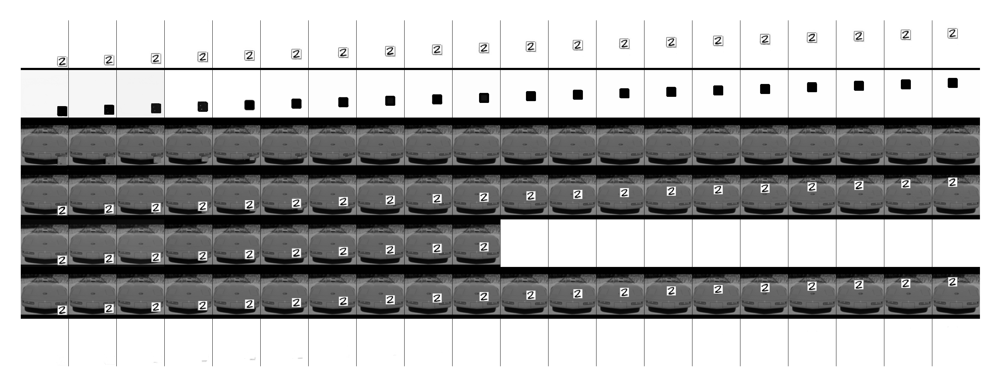

Data: min and max 6.889269e-08 0.9999987
Data[ 0 ]: min and max 0.0 1.0


<b><span style="color: #ff0000">Pred,Cor (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


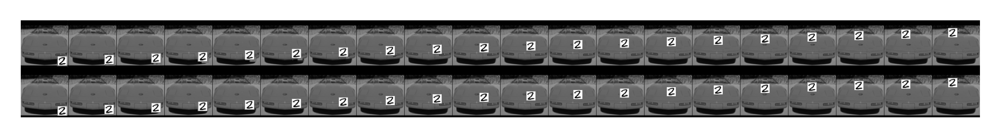

Data: min and max -1.0 1.0
Data[ 0 ]: min and max -1.0 1.0


<b><span style="color: #ff0000">TEstRes (N) (r)</span></b>  (1, 20, 262, 128, 1)

Image: min and max 0.0 1.0


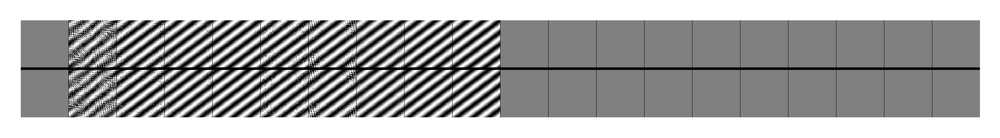

BCEMin= 0.5287873054494953  BCE= 0.530326782476784  L1= 0.0024114719668108194  L2= 0.00029001670255899745  SSIM= 0.9896695767298783


BaseException: end here

In [14]:
criterion = torch.nn.MSELoss().to(avDev)
minLR=[0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001]
maxLR=[0.001,0.001,0.001,0.001,0.001,0.001,0.001,0.001]

gainLR=[1,1,1,1,1,1,1,1]
totalGainLR=0.01
minLR=[d*gainLR[i]*totalGainLR for i,d in enumerate(minLR)] 
maxLR=[d*gainLR[i]*totalGainLR for i,d in enumerate(maxLR)]

print(maxLR)
optimizer = torch.optim.Adam([
    {'params': learnableGainsInit, 'lr': minLR[0],'weight_decay':10e-12},
    {'params': learnableGains, 'lr': minLR[1],'weight_decay':10e-12},
    {'params': learnableGainsF, 'lr': minLR[2],'weight_decay':0},
    {'params': learnableGainsTeS, 'lr': minLR[3],'weight_decay':0},
    {'params': learnableGainsDOG, 'lr': minLR[4],'weight_decay':10e-12},
    {'params': modelA.parameters(), 'lr': minLR[5]},
    {'params': modelBG.parameters(), 'lr': minLR[6]},
    {'params': modelFG.parameters(), 'lr': minLR[7]},
])

scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer,total_steps=200,
                                              max_lr=maxLR)

sumP=0
for i in optimizer.param_groups:
    sumP+=sum(p.numel() for p in i["params"] if p.requires_grad)
print("Number of params=",sumP)
if infrencePhase:
    rand.seed(1);np.random.seed(1);t=0;infrenceRes=[]
if infrencePhase:
    paintEvery=7
else:
    paintEvery=200
saveEvery=1000
if infrencePhase:
    bs=10
else:
    bs=10

if infrencePhase:
    runs=100
else:
    runs=2000000

if experiment is not None:
    experiment.end()
experiment = Experiment(api_key="?",#Your api_key
                        project_name="esann2020", workspace="?",disabled=True)
experiment.log_asset_folder("asset")
experiment.set_name(theNotebook)

SHOWINTER=False
SHOWBEST=False
bestLoss=2
step=1

t=0
ds_loader = DataLoader(ds,batch_size=bs, shuffle=not infrencePhase,num_workers=8,worker_init_fn=worker_init_fn)
ds_iter=iter(ds_loader)
while t <= runs:
    if(t%1==0):
        try:
            s=next(ds_iter)
        except StopIteration:
            ds_iter=iter(ds_loader)
            s=next(ds_iter)
        
        dataSet=s['GT'].to(avDev)
        dsBG=s['BG'].to(avDev)
        dsFG=s['FG'].to(avDev)
        dsAlpha=s['A'].to(avDev)
        dsVel=s["velocity"]


    if(t%paintEvery==0):
        if not infrencePhase:
            clear_output()
        SHOWBEST=True
        SHOWINTER=False
    else:
        SHOWBEST=False
        SHOWINTER=False
    
    optimizer.zero_grad()
    pre_frames_batch,loss,l,tres=optimizeIt({})
    
    
    ll=2*l[:,:,0:10,:,:].mean()+1*l[:,:,10:,:,:].mean()
    ll=ll
    
    netOut = pre_frames_batch[:,:,seedNumber:,:,:]
    target = dataSet[:,:,seedNumber:,:,:]
    
    bceNetFull = critBCE(netOut,target)
    
    bceNet=bceNetFull
    bceMin=critBCE(target,target)
    L1NetDiff = (netOut-target).abs()
    L1Net=L1NetDiff.mean()
    L2Net=critL2(netOut,target)

    ssimL=ssim(netOut.reshape(netOut.shape[0]*netOut.shape[2],1,netOut.shape[3],netOut.shape[4]), target.reshape(target.shape[0]*target.shape[2],1,target.shape[3],target.shape[4]))

    experiment.log_metric("currentLoss", ll.item(), step=t)
    experiment.log_metric("L2Loss", L2Net.item(), step=t)
    pp.update([[ll.item()],[L2Net.item()],[scheduler.get_lr()[0]]])

    if t%1==0:
        lblLoss.value=('<span style="color: green">'+'%05d' % t+" Prediction L2:"+" %.8f" % loss+" CUR Loss:"+" %.8f" % ll.item()+"</span>")
        lblTotalLoss.value="bceMin="+" %0.5f" %bceMin.item()+" bceNetFull="+" %0.5f" %bceNetFull.item()+" bceNet="+" %0.5f" %bceNet.item()+" L1Net="+" %0.5f" %L1Net.item()+" L2Net="+" %0.5f" %L2Net.item()+" SSIM="+"%0.5f" %ssimL.item()
        lblLR.value=', '.join('{:0.5f}'.format(i) for i in scheduler.get_lr())
        def niceL2S(l):
            return pd.DataFrame(l.detach().cpu().numpy()).style.format("{0:.5f}")

        output = widgets.Output()
        with output:
            display(niceL2S(learnableGainsInit))
            display(niceL2S(torch.sigmoid(learnableGains[0:3,0:seedNumber])))
            display(niceL2S(torch.abs(learnableGainsF[:,0])))
            display(niceL2S(torch.sigmoid(learnableGainsF[:,1:seedNumber])))
            display(niceL2S(torch.sigmoid(learnableGainsTeS[:,1:seedNumber])))
            display(niceL2S(torch.abs(learnableGainsDOG[:,0:seedNumber])))
        oGains.children=tuple([output])
        box = VBox(children=[lblLoss,lblTotalLoss,lblLR,oGains],)
    
    if not infrencePhase:
        (ll+0.00000*(tres*tres)).backward()
        optimizer.step()
        scheduler.step(t%scheduler.total_steps)
    else:
        infrenceRes.append([bceMin.item(),bceNet.item(),L1Net.item(),L2Net.item(),ssimL.item()]) 
        
    t=t+1
    
    if(infrencePhase and t>runs):
        infrenceRes=np.array(infrenceRes)
        print("BCEMin=",infrenceRes[:,0].mean()," BCE=",infrenceRes[:,1].mean()," L1=",infrenceRes[:,2].mean()," L2=",infrenceRes[:,3].mean()," SSIM=",infrenceRes[:,4].mean())
        raise BaseException("end here")
#Be aware that when the input of something is the output of the same module it should be train gradually!

In [ ]:
pp.finalize()
experiment.end()

In [ ]:
torch.save({"learnableGains":learnableGains,
          "learnableGainsInit":learnableGainsInit,
          "learnableGainsF":learnableGainsF,
          "learnableGainsTeS":learnableGainsTeS,
           "learnableGainsDOG":learnableGainsDOG,
           "modelA":modelA.state_dict(),
           "modelBG":modelBG.state_dict(),
           "modelFG":modelFG.state_dict(),
           
           },"savedModels/"+theNotebook+".th")
